<a href="https://colab.research.google.com/github/kumar306Ankit/Diagnose-the-Fault-of-a-rotor-bearing-system-using-machine-learning-/blob/main/Project_Part_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Fault diagnosis of a rotor-bearing system using machine learning techniques**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Abstract:**

In the fields of science and engineering, classification of faults in rotary machines using machine learning is gaining popularity. A common mistake in rotating machinery is misalignment. In order to identify misalignments in rotary machines under various circumstances, this project suggests a method based on machine learning techniques. To find misalignment faults, a personalized diagnostic fault method is suggested.

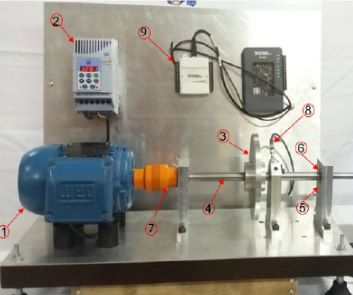

# Visualise

## Import Libraries

In [2]:
pip install librosa

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
!pip install python_speech_features

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for python_speech_features: filename=python_speech_features-0.6-py3-none-any.whl size=5886 sha256=f9e6a763778fc990d5d4d540985b59ae69241cbc2ca524e4f115a7fd38c6c289
  Stored in directory: /root/.cache/pip/wheels/5a/9e/68/30bad9462b3926c29e315df16b562216d12bdc215f4d240294
Successfully built python_speech_features


In [4]:
import keras

In [5]:
import librosa
from glob import glob
from keras.utils import to_categorical
from scipy.io import wavfile
from keras.layers import Conv2D, MaxPool2D, Flatten, LSTM
from keras.layers import Dropout, Dense, TimeDistributed
from keras.models import Sequential
from keras.utils import to_categorical
from sklearn.utils.class_weight import compute_class_weight
import os
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from python_speech_features import mfcc, logfbank 
import librosa
import soundfile as sf
import numpy as np
import wave
import struct

## Import Dataset and Visualise
The dataset was divided into three parts, Pressure, Displacement and Force. The columns were named NON_FAULTY, RIGHT_AND_LEFT_BEARING, Right_Bearing and UNBALANCE_FORCE in all the datasets.

> These three datasets were imported separately and On each of their columns Fast Fourier Transform were applied and Visualise

### Observation


> It was observed that they were showing good variation even for small time intervals. Therefore, it is not possible to simply make a Mel Spectrogram and apply CNN since each node would get split several parts due to FFT, and this would lead to data loss and hence, a poor accuracy. This is why the columns were first coverted into sound signals.





### Import Pressure Dataset

In [6]:
# Read the CSV file
df_pressure = pd.read_csv('/content/drive/MyDrive/Design Credit/DataSet/csv/Pressure.csv')

# Loop through the sheets and process the data
for sheet_name, sheet_data in df_pressure.items():
    # Do some processing on the sheet data
    print(f"Processing sheet {sheet_name}")
    # Use Librosa to analyze the audio data in the sheet


Processing sheet P1(NON_FAULTY)
Processing sheet P2(NON_FAULTY)
Processing sheet P3(NON_FAULTY)
Processing sheet P1(Right_Bearing)
Processing sheet P2(Right_Bearing)
Processing sheet P3(Right_Bearing)
Processing sheet P1(RIGHT_AND LEFT_BEARING)
Processing sheet P2(RIGHT_AND LEFT_BEARING)
Processing sheet P3(RIGHT_AND LEFT_BEARING)
Processing sheet P1(UNBALANCE_FORCE)
Processing sheet P2(UNBALANCE_FORCE)
Processing sheet P3(UNBALANCE_FORCE)


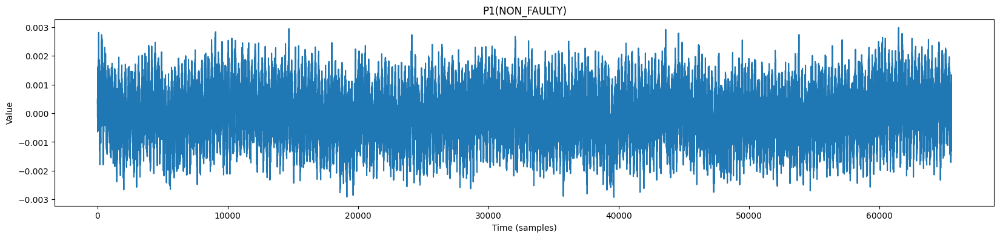

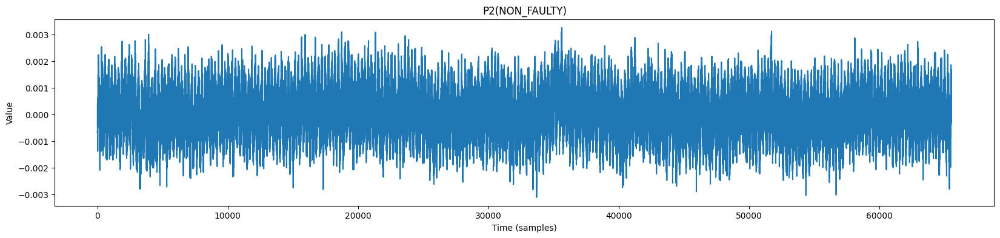

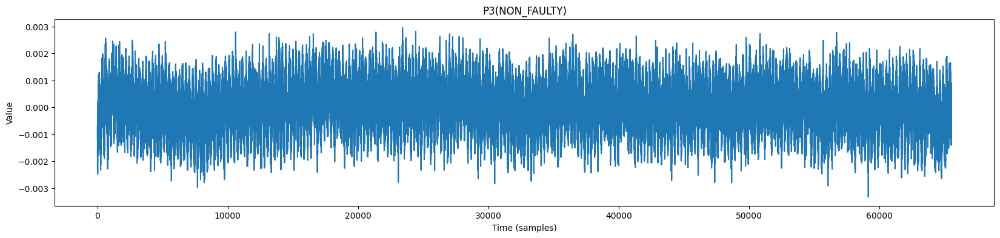

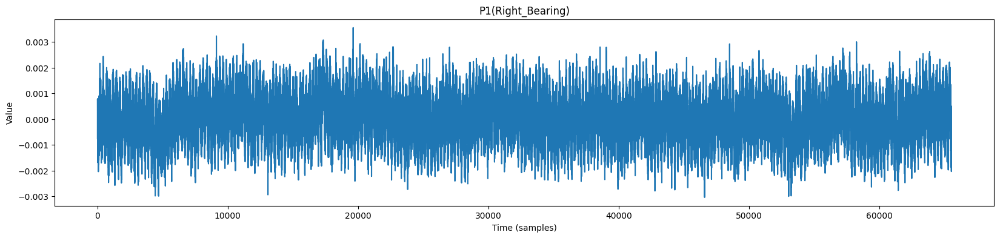

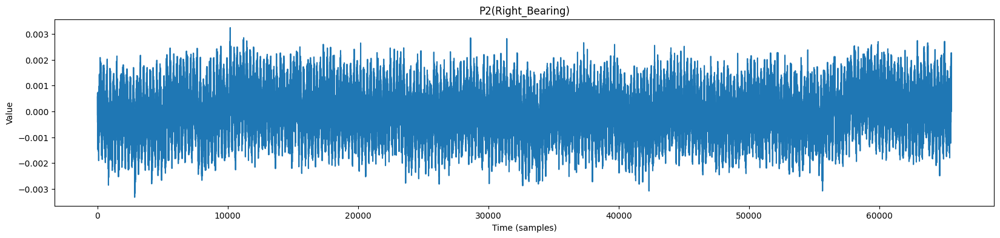

...

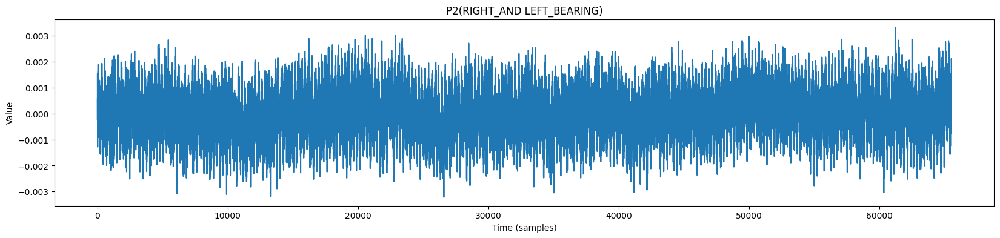

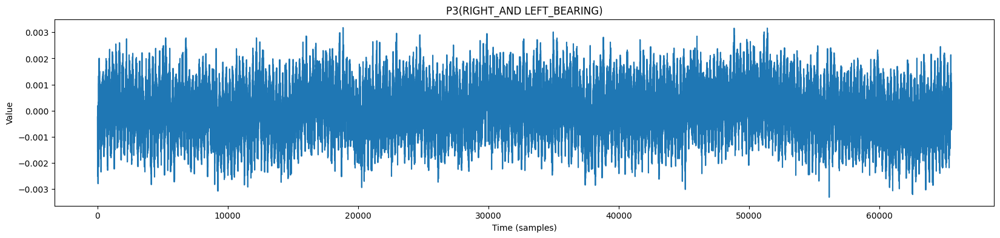

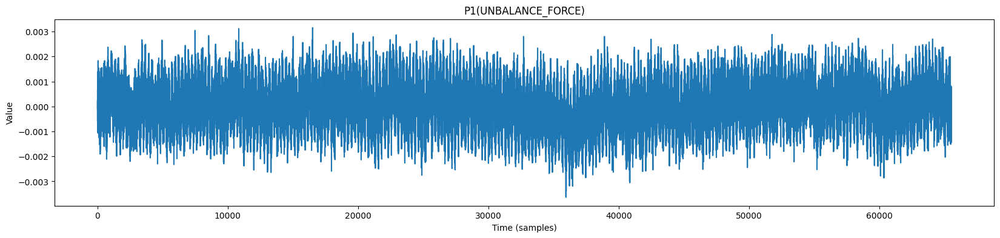

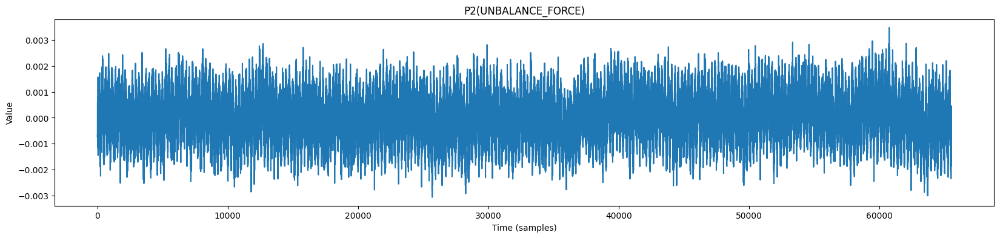

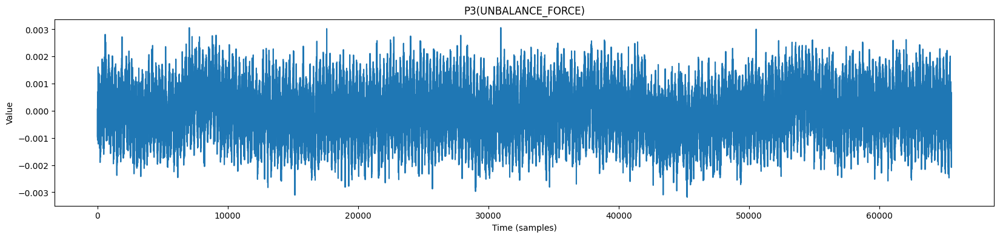

In [7]:
col_names_pressure = df_pressure.columns

# Loop through each column and create a plot
for col_name in col_names_pressure:
    # Create a new figure for each plot
    fig = plt.figure(figsize=(20, 4))
    # Plot the data
    plt.plot(df_pressure[col_name])
    # Set the title and axis labels
    plt.title(col_name)
    plt.xlabel('Time (samples)')
    plt.ylabel('Value')
    # Show the plot
    plt.show()

### Import Dispalcement Dataset

In [8]:
# Read the CSV file
df_displacement = pd.read_csv('/content/drive/MyDrive/Design Credit/DataSet/csv/Displacement.csv')

# Loop through the sheets and process the data
for sheet_name, sheet_data in df_displacement.items():
    # Do some processing on the sheet data
    print(f"Processing sheet {sheet_name}")
    # Use Librosa to analyze the audio data in the sheet


Processing sheet D1(NON_FAULTY)
Processing sheet D2(NON_FAULTY)
Processing sheet D3(NON_FAULTY)
Processing sheet D1(Right_Bearing)
Processing sheet D2(Right_Bearing)
Processing sheet D3(Right_Bearing)
Processing sheet D1(RIGHT_AND LEFT_BEARING)
Processing sheet D2(RIGHT_AND LEFT_BEARING)
Processing sheet D3(RIGHT_AND LEFT_BEARING)
Processing sheet D1(UNBALANCE_FORCE)
Processing sheet D2(UNBALANCE_FORCE)
Processing sheet D3(UNBALANCE_FORCE)


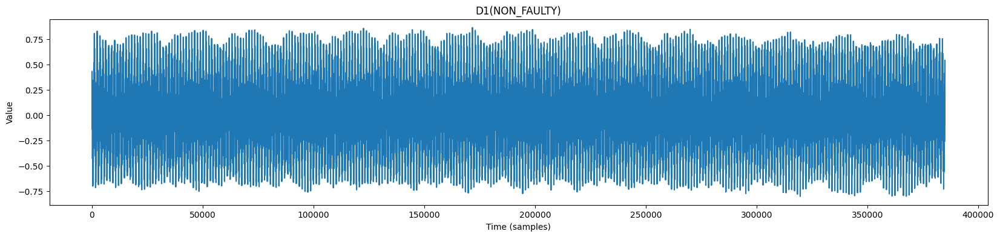

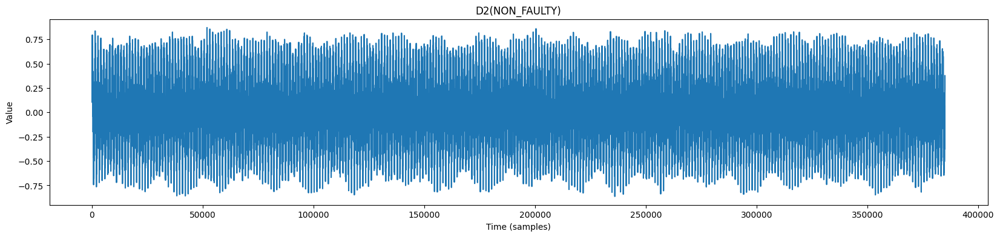

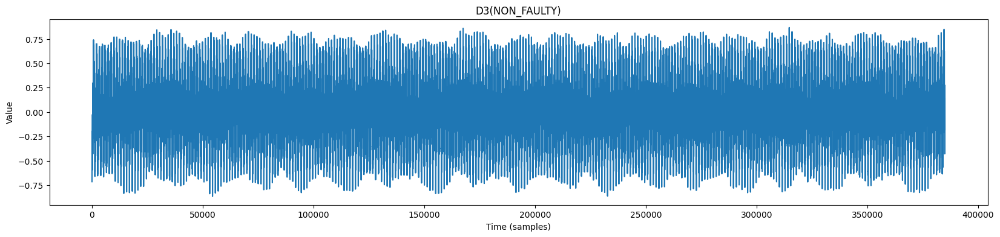

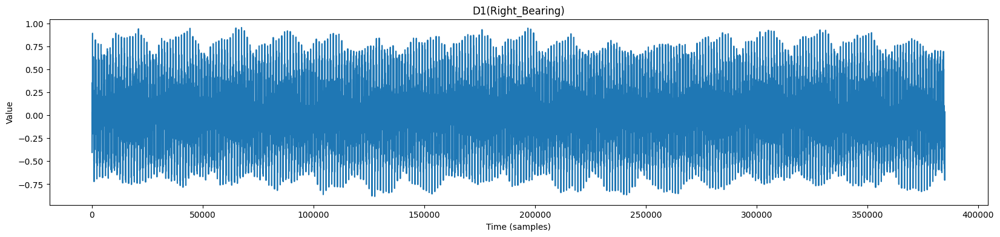

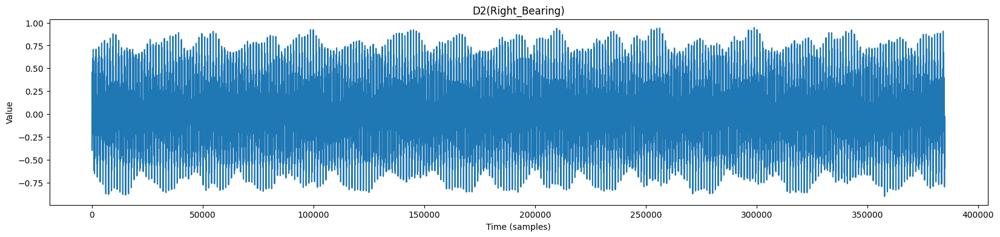

...

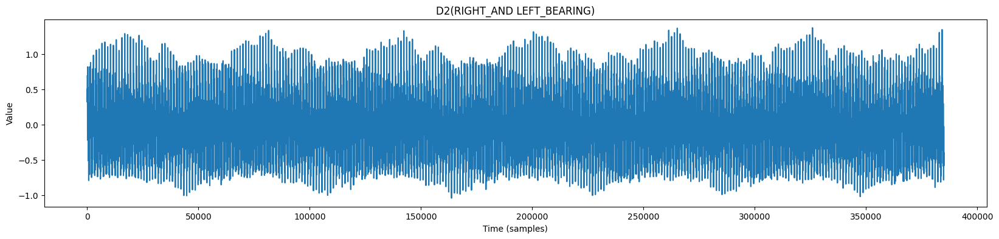

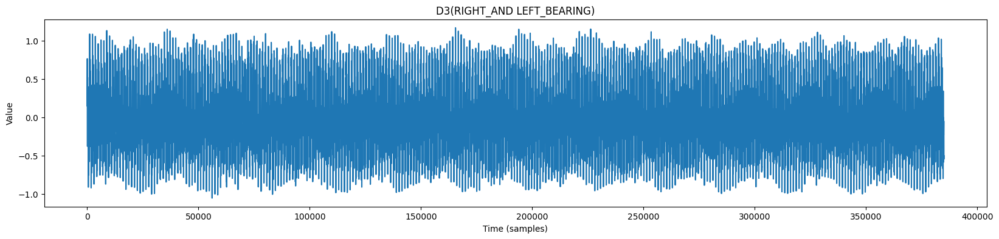

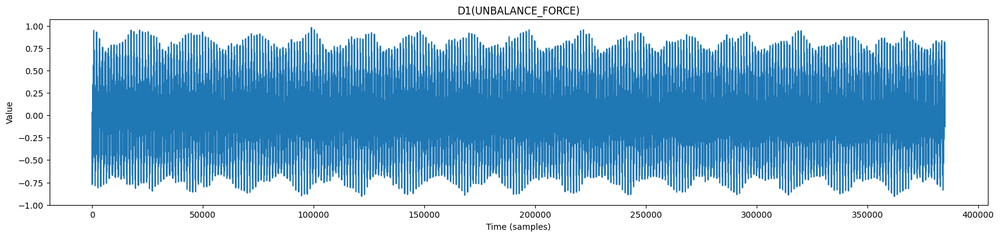

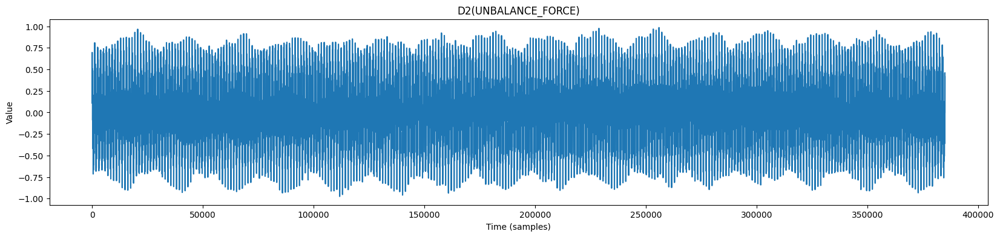

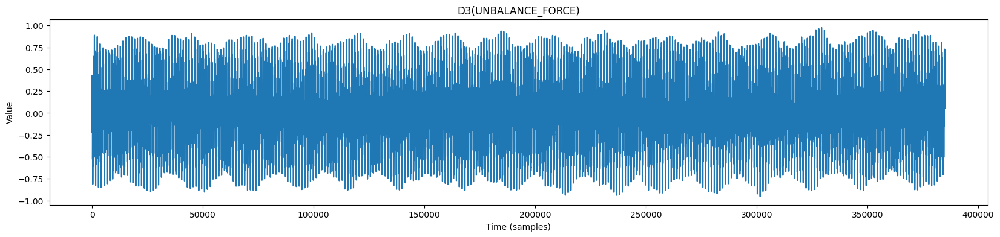

In [9]:
col_names_displacement = df_displacement.columns

# Loop through each column and create a plot
for col_name in col_names_displacement:
    # Create a new figure for each plot
    fig = plt.figure(figsize=(20, 4))
    # Plot the data
    plt.plot(df_displacement[col_name])
    # Set the title and axis labels
    plt.title(col_name)
    plt.xlabel('Time (samples)')
    plt.ylabel('Value')
    # Show the plot
    plt.show()

### Import Force Dataset

In [10]:
# Read the CSV file
df_Force = pd.read_csv('/content/drive/MyDrive/Design Credit/DataSet/csv/Force.csv')

# Loop through the sheets and process the data
for sheet_name, sheet_data in df_Force.items():
    # Do some processing on the sheet data
    print(f"Processing sheet {sheet_name}")
    # Use Librosa to analyze the audio data in the sheet


Processing sheet N1(NON_FAULTY)
Processing sheet N2(NON_FAULTY)
Processing sheet N3(NON_FAULTY)
Processing sheet N1(Right_Bearing)
Processing sheet N2(Right_Bearing)
Processing sheet N3(Right_Bearing)
Processing sheet N1(RIGHT_AND LEFT_BEARING)
Processing sheet N2(RIGHT_AND LEFT_BEARING)
Processing sheet N3(RIGHT_AND LEFT_BEARING)
Processing sheet N1(UNBALANCE_FORCE)
Processing sheet N2(UNBALANCE_FORCE)
Processing sheet N3(UNBALANCE_FORCE)


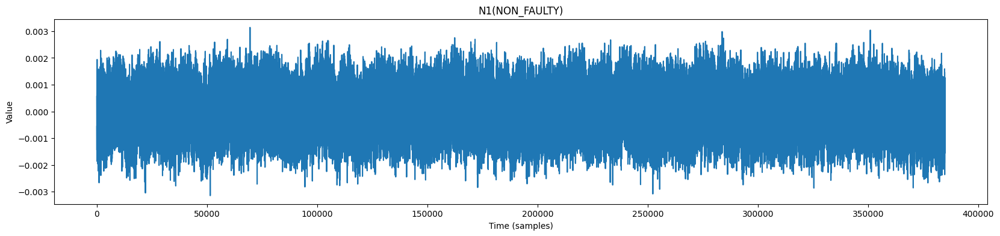

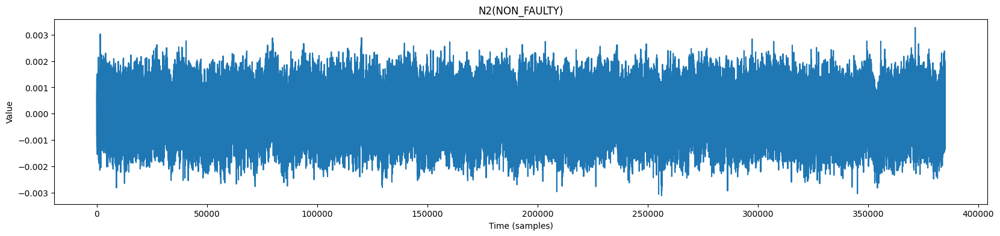

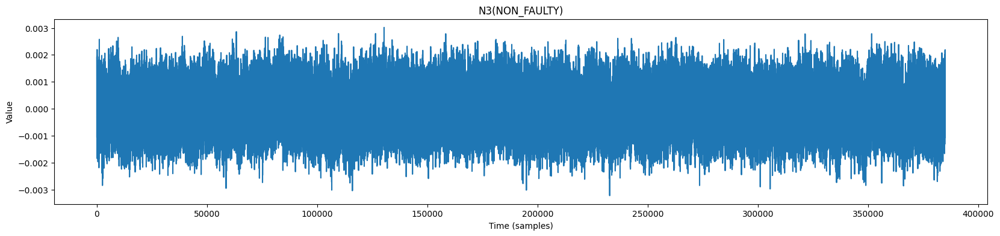

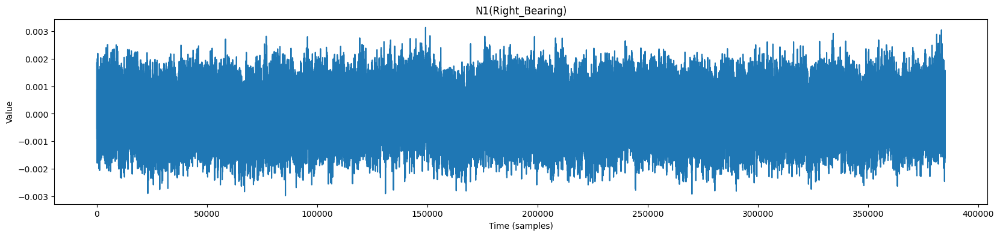

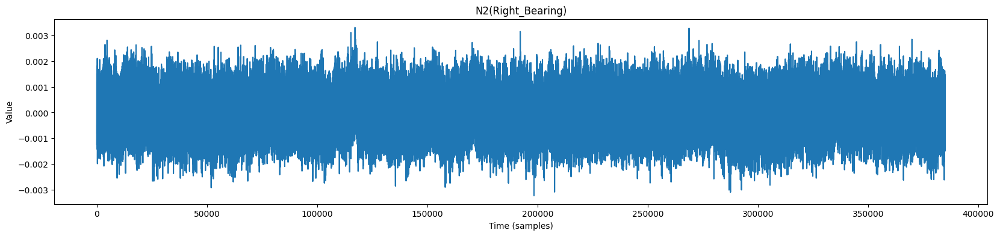

...

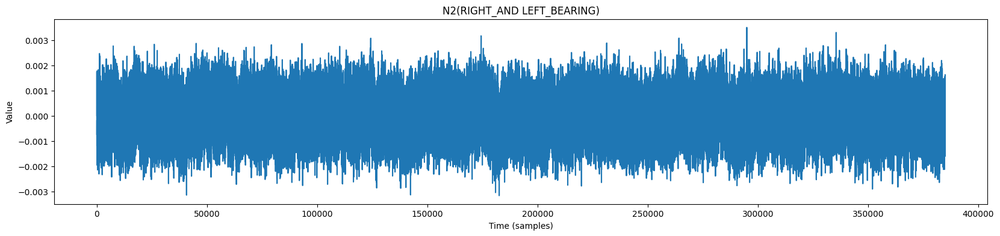

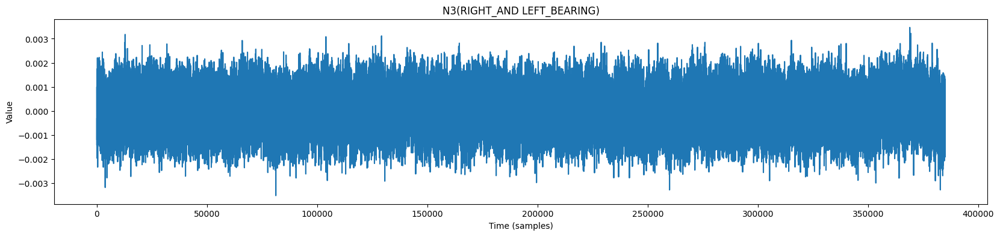

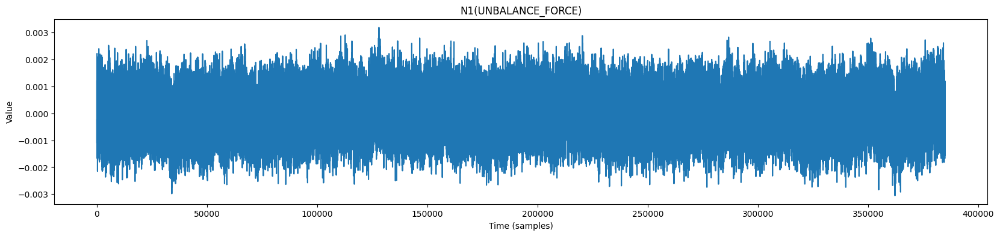

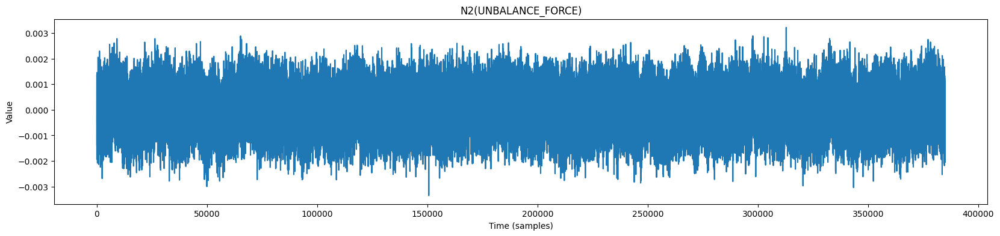

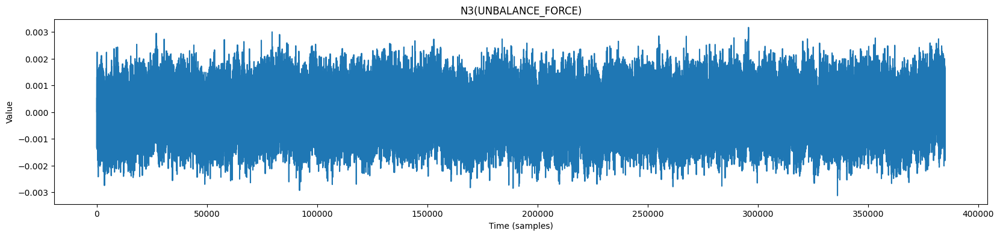

In [11]:
col_names_Force = df_Force.columns

# Loop through each column and create a plot
for col_name in col_names_Force:
    # Create a new figure for each plot
    fig = plt.figure(figsize=(20, 4))
    # Plot the data
    plt.plot(df_Force[col_name])
    # Set the title and axis labels
    plt.title(col_name)
    plt.xlabel('Time (samples)')
    plt.ylabel('Value')
    # Show the plot
    plt.show()

## Saving Dataset in form of sound

Each column of the previously imported three datasets is now converted into a sound signal.

> The sample rate for constructing the sound signals from columns was set to 1/7.8e-5 because the sensor was collecting data with a time period of 7.8e-5 s for a time interval of 30s.

In [12]:
for col_name in col_names_pressure:
    # Convert the column to a NumPy array
    audio_data = df_pressure[col_name].to_numpy()
    # Replace NaN values with zeros
    audio_data = np.where(np.isnan(audio_data), 0, audio_data)
    # Normalize the audio data to the range [-1, 1]
    audio_data /= max(abs(audio_data))
    # Set the sample rate (in Hz)
    sample_rate = int(1/7.8e-5)
    # Set the number of channels
    nchannels = 1 if len(audio_data.shape) == 1 else audio_data.shape[1]
    # Open a new WAV file for writing
    with wave.open(f'{col_name}.wav', 'w') as wav_file:
        # Set the parameters of the WAV file
        sampwidth = 2
        comptype = "NONE"
        compname = "not compressed"
        # Set the sample rate, number of channels, and number of frames
        wav_file.setparams((nchannels, sampwidth, sample_rate, len(audio_data), comptype, compname))
        # Write each audio sample to the file
        for sample in audio_data.flatten():
            sample = int(sample * 32767) # Convert to 16-bit integer
            wav_file.writeframes(struct.pack('h', sample))


In [13]:
for col_name in col_names_displacement:
    # Convert the column to a NumPy array
    audio_data = df_displacement[col_name].to_numpy()
    # Replace NaN values with zeros
    audio_data = np.where(np.isnan(audio_data), 0, audio_data)
    # Normalize the audio data to the range [-1, 1]
    audio_data /= max(abs(audio_data))
    # Set the sample rate (in Hz)
    sample_rate = int(1/7.8e-5)
    # Set the number of channels
    nchannels = 1 if len(audio_data.shape) == 1 else audio_data.shape[1]
    # Open a new WAV file for writing
    with wave.open(f'{col_name}.wav', 'w') as wav_file:
        # Set the parameters of the WAV file
        sampwidth = 2
        comptype = "NONE"
        compname = "not compressed"
        # Set the sample rate, number of channels, and number of frames
        wav_file.setparams((nchannels, sampwidth, sample_rate, len(audio_data), comptype, compname))
        # Write each audio sample to the file
        for sample in audio_data.flatten():
            sample = int(sample * 32767) # Convert to 16-bit integer
            wav_file.writeframes(struct.pack('h', sample))


In [14]:
for col_name in col_names_Force:
    # Convert the column to a NumPy array
    audio_data = df_Force[col_name].to_numpy()
    # Replace NaN values with zeros
    audio_data = np.where(np.isnan(audio_data), 0, audio_data)
    # Normalize the audio data to the range [-1, 1]
    audio_data /= max(abs(audio_data))
    # Set the sample rate (in Hz)
    sample_rate = int(1/7.8e-5)
    # Set the number of channels
    nchannels = 1 if len(audio_data.shape) == 1 else audio_data.shape[1]
    # Open a new WAV file for writing
    with wave.open(f'{col_name}.wav', 'w') as wav_file:
        # Set the parameters of the WAV file
        sampwidth = 2
        comptype = "NONE"
        compname = "not compressed"
        # Set the sample rate, number of channels, and number of frames
        wav_file.setparams((nchannels, sampwidth, sample_rate, len(audio_data), comptype, compname))
        # Write each audio sample to the file
        for sample in audio_data.flatten():
            sample = int(sample * 32767) # Convert to 16-bit integer
            wav_file.writeframes(struct.pack('h', sample))


## Preprocess Sound

### Functions
Functions were made to plot signals, mel spectrogram and an envelope function which removes dead space from the signal.

In [15]:
def plot_signal(signal, title):
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')
    ax.set_title(title)
    x = np.arange(len(signal))
    y = np.ones_like(x)
    z = signal
    ax.plot(x, y, z)
    ax.set_autoscale_on(True) # enable autoscaling
    ax.set_xlabel('Sample')
    ax.set_ylabel('Signal')
    ax.set_zlabel('Amplitude')
    plt.show()

def plot_signals(signals):
    for key, signal in signals.items():
        plot_signal(signal[:150000], key)
def plot_fft(fft):
    for i, (label, (Y, freq)) in enumerate(fft.items()):
        plt.figure(figsize=(10, 6))
        plt.plot(freq, Y)
        plt.title(label)
        plt.xlim([0,2000])
        plt.ylim([0,0.0150])
        plt.xlabel('Frequency (Hz)')
        plt.ylabel('Magnitude')

def calc_fft(y, rate):
    n = len(y)
    freq = np.fft.rfftfreq(n, d=1/rate)
    Y = abs(np.fft.rfft(y)/n)
    return (Y, freq)
def envelope (y, rate, threshold):
    mask = []
    y = pd.Series (y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10), min_periods=1, center=True).mean()

    for mean in y_mean:
        if mean == threshold: 
          mask.append(True)
        else:
          mask.append(False)
    return mask
def plot_fbank(fbank):
    fig, axes = plt.subplots(nrows=len(fbank), ncols=1, sharex=False, sharey=True, figsize=(5,130))
    for i, (key, val) in enumerate(fbank.items()):
        axes[i].set_title(key)
        axes[i].imshow(val, cmap='hot', interpolation='nearest', aspect='auto')
        axes[i].get_xaxis().set_visible(False)
        axes[i].get_yaxis().set_visible(False)

def plot_mfccs(mfccs):
    fig, axes = plt.subplots(nrows=len(mfccs), ncols=1, sharex=False, sharey=True, figsize=(5,130))
    for i, (key, val) in enumerate(mfccs.items()):
        axes[i].set_title(key)
        axes[i].imshow(val, cmap='hot', interpolation='nearest', aspect='auto')
        axes[i].get_xaxis().set_visible(False)
        axes[i].get_yaxis().set_visible(False)

### Distribution of data
The distribution of data with respect to Class 1, Class 2, Class 3 and Class 4 was visualized.

Class 1 is Non-Faulty

Class 2 is Right and Left Bearing Fault

Class 3 is Right Bearing

Class 4 is Unbalance Force

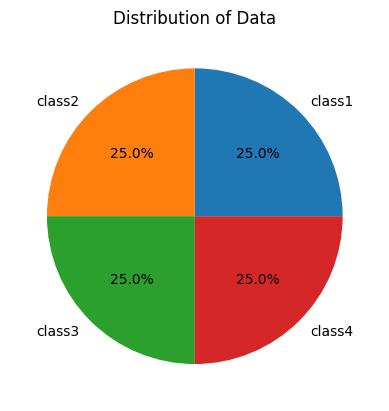

In [16]:
# Path to the main directory containing class folders
main_dir = '/content/drive/MyDrive/Design Credit/train_audio'

# Get a list of subdirectories (i.e. class folders) in the main directory
subdirs = [x[0] for x in os.walk(main_dir)][1:]

# Count the number of .wav files in each subdirectory
counts = []
for subdir in subdirs:
    wav_count = len([file for file in os.listdir(subdir) if file.endswith('.wav')])
    counts.append(wav_count)

# Plot a pie chart of the counts
labels = [os.path.basename(subdir) for subdir in subdirs]
plt.pie(counts, labels=labels, autopct='%1.1f%%')
plt.title('Distribution of Data')
plt.show()

### Visualise Dataset Before Envelop
Signal Mel Spectrogram and FFT was visualized and it was observed that there were many dead spaces.

In [17]:
signals = {}
fft = {}
fbank = {} 
mfccs = {}

# Loop through each subdirectory and load the .wav files
for c in subdirs:
    wav_files = [f for f in os.listdir(c) if f.endswith('.wav')]
    for wav_file in wav_files:
        wav_path = os.path.join(c, wav_file)
        signal, rate = librosa.load(wav_path, sr=44100)
        signals[wav_path] = signal
        fft[wav_path] = calc_fft(signal, rate)
        bank = logfbank(signal[:rate], rate, nfilt=26, nfft=1103).T
        fbank[wav_path] = bank
        mel = mfcc(signal[:rate], rate, numcep=13, nfilt=26, nfft=1103).T
        mfccs[wav_path] = mel

# Plot the signals, FFT, filterbank energies, and MFCCs

#### Plot Signal

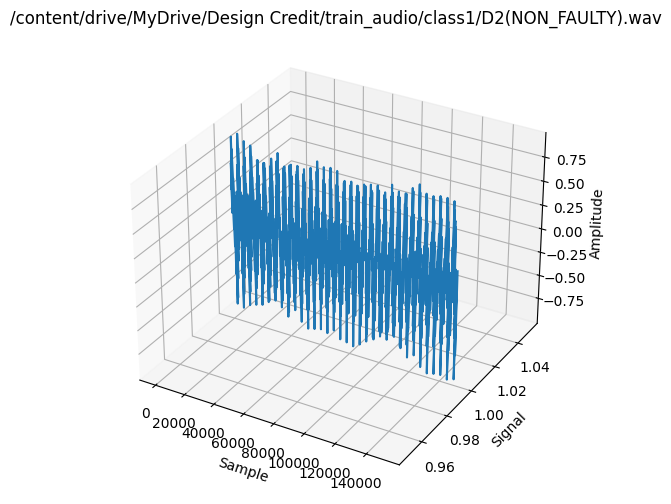

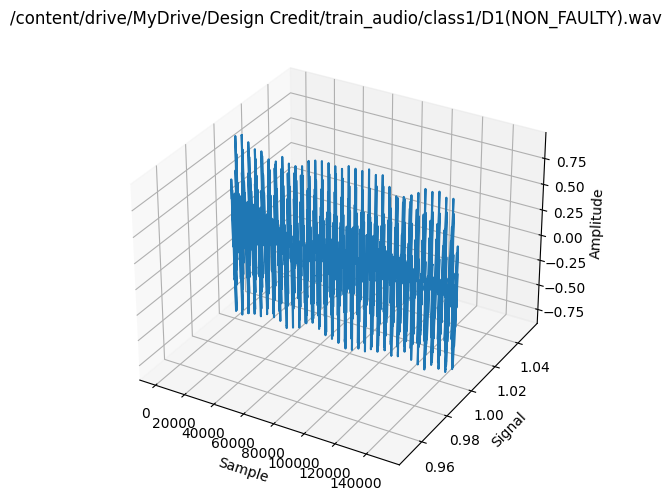

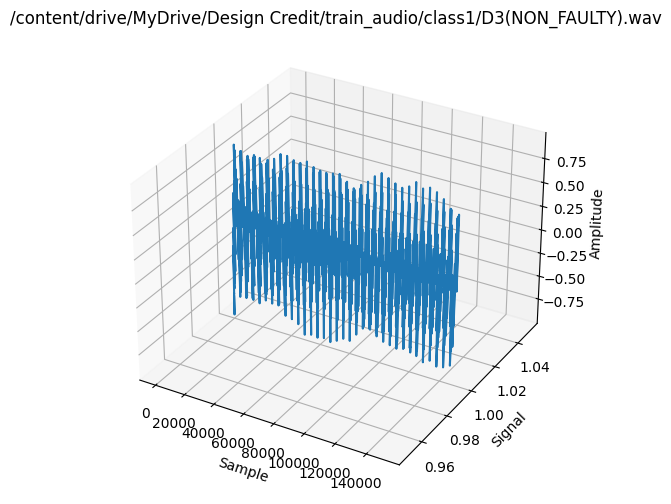

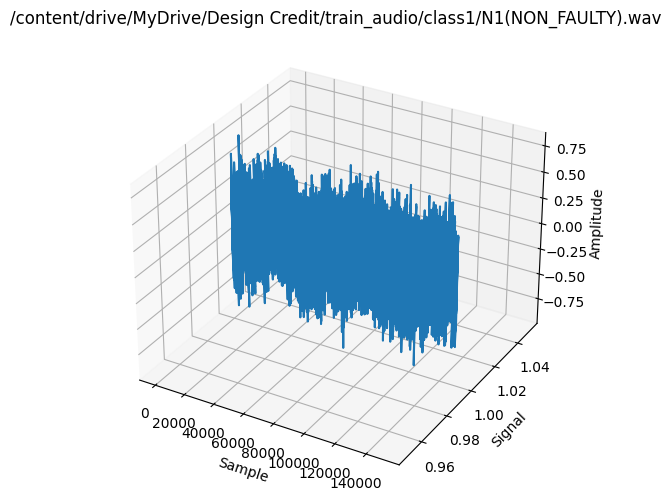

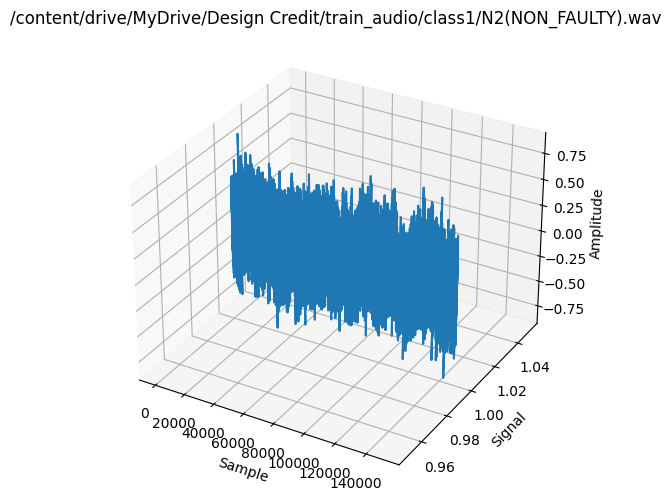

...

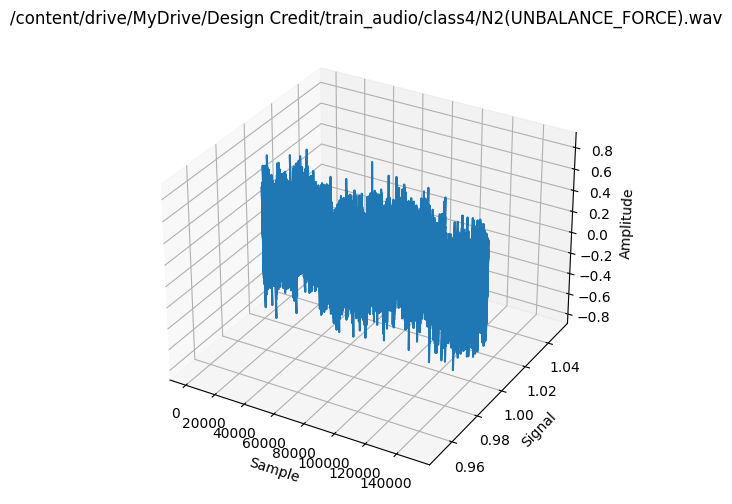

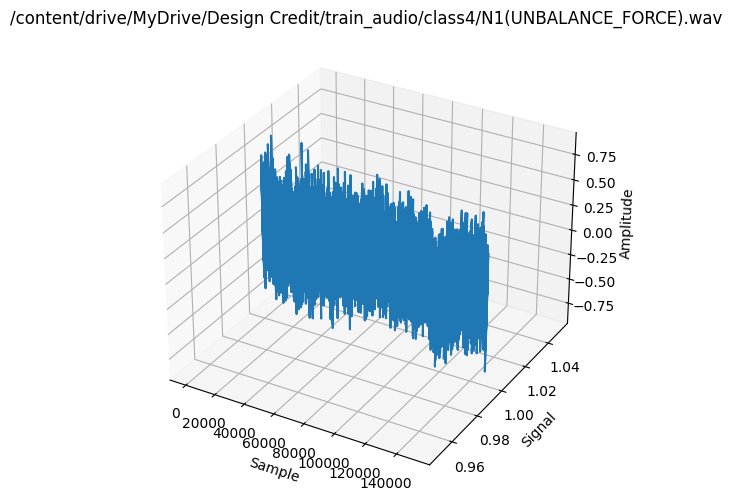

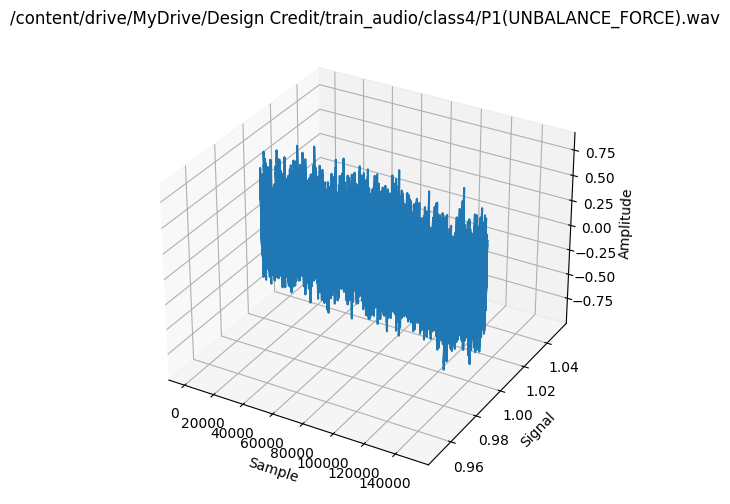

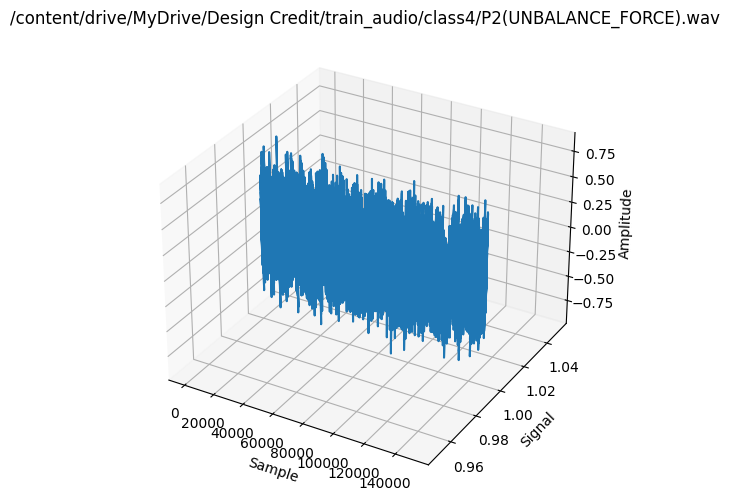

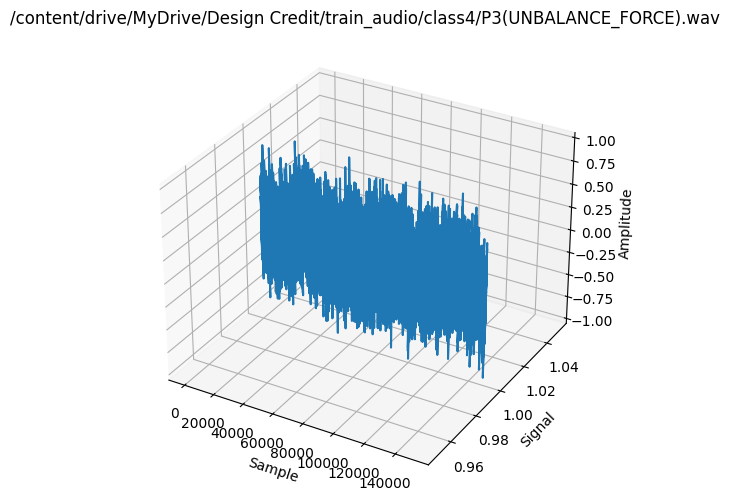

In [18]:
plot_signals(signals) 


#### Plot fft

<ipython-input-15-b3b987038d3f>:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 6))


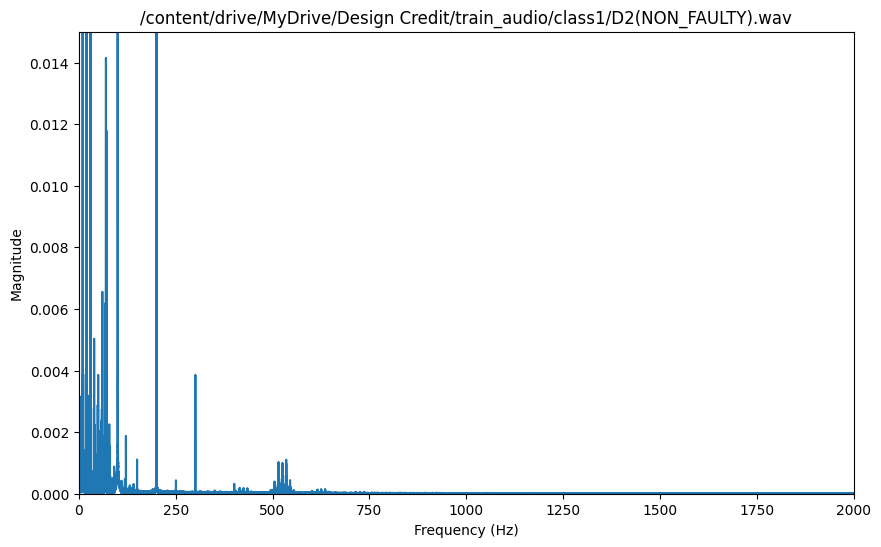

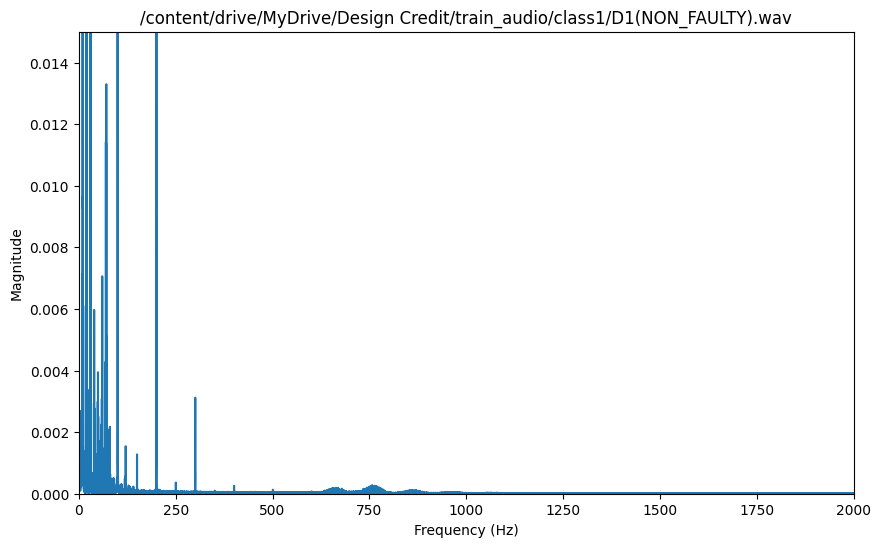

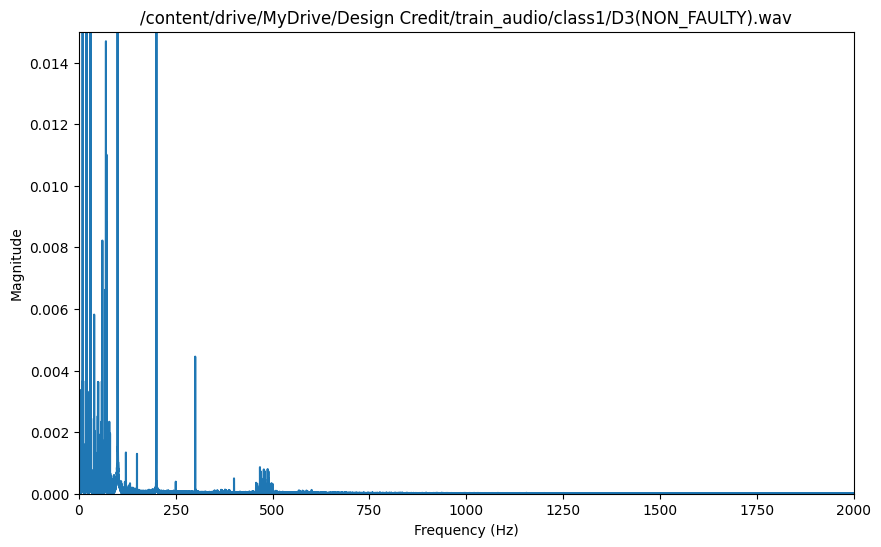

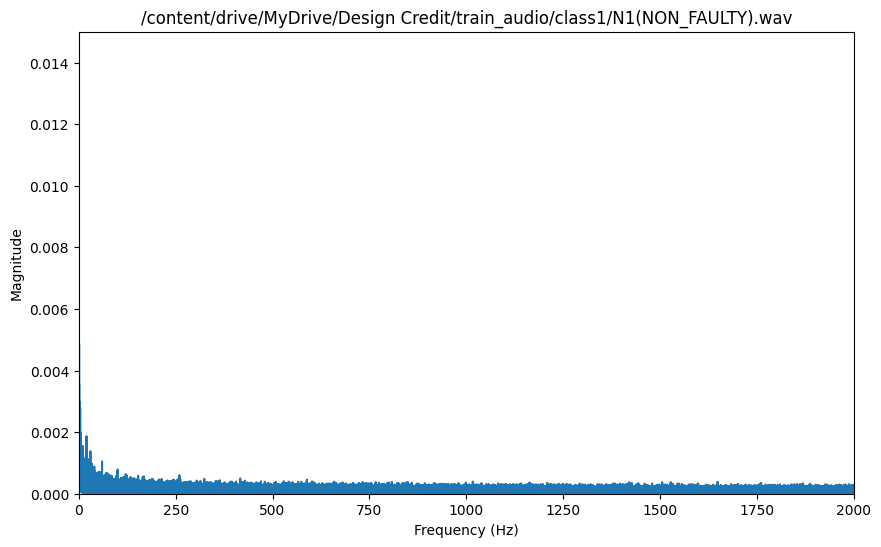

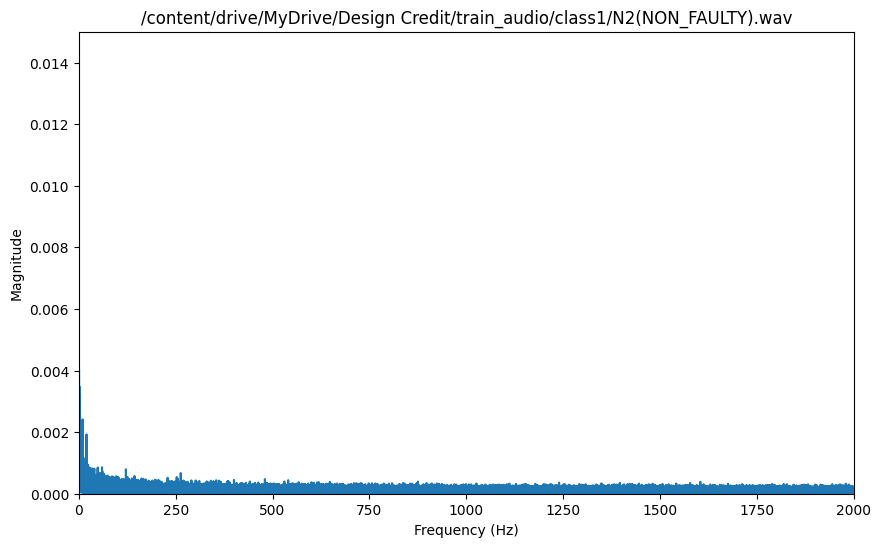

...

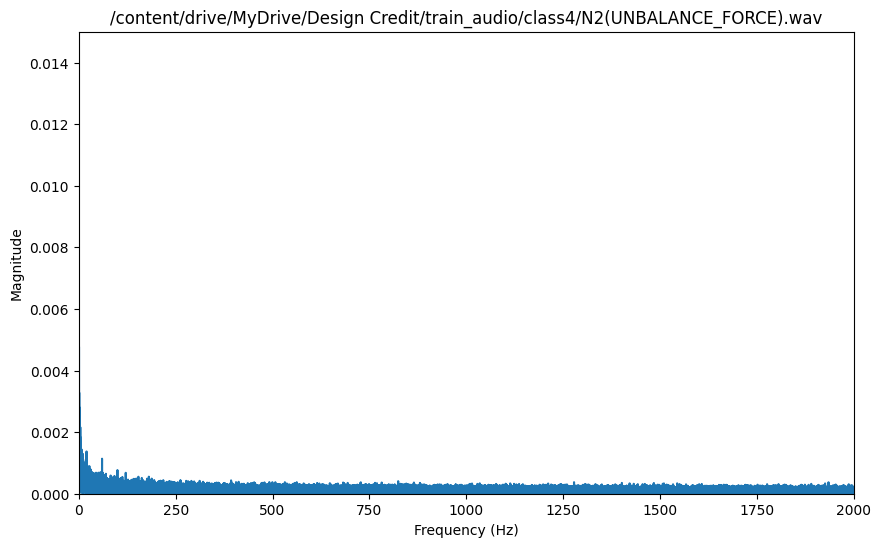

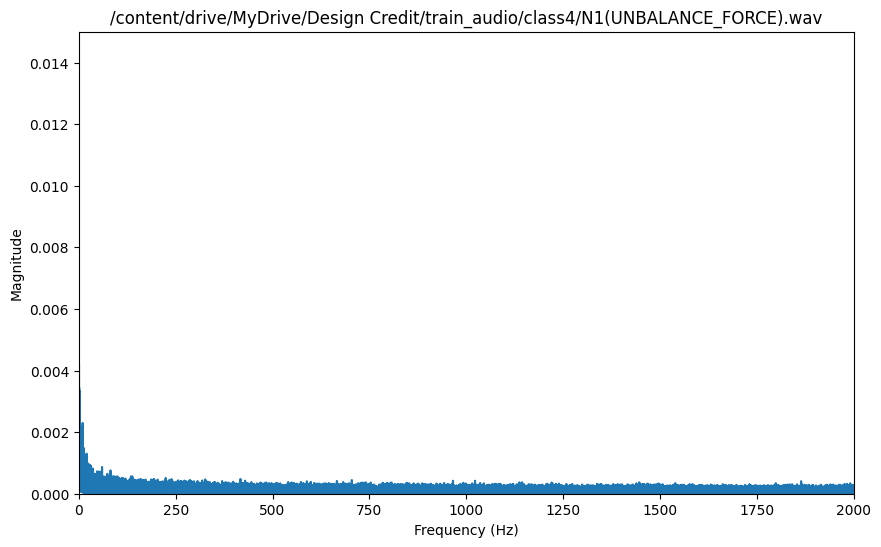

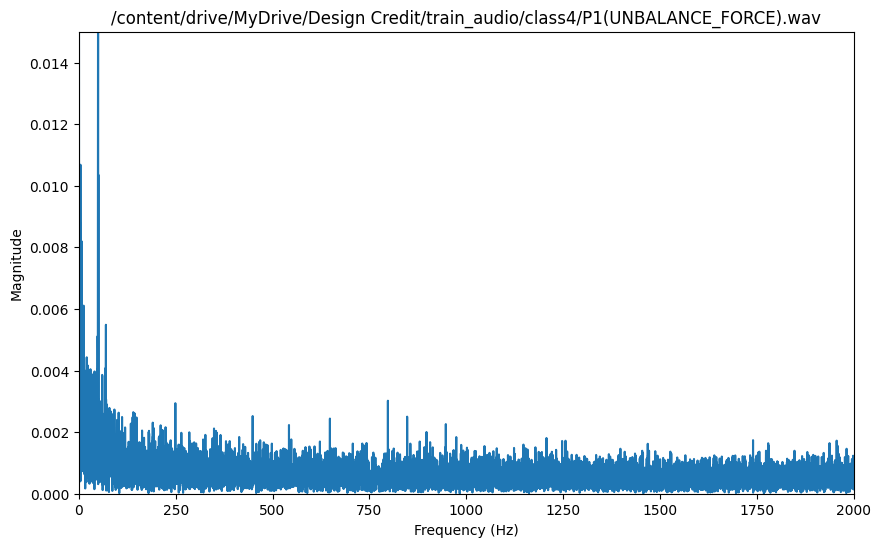

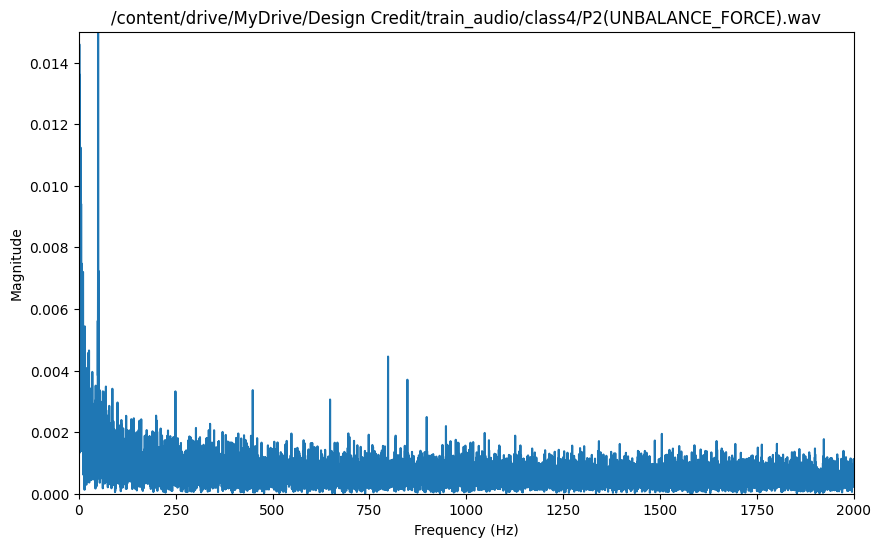

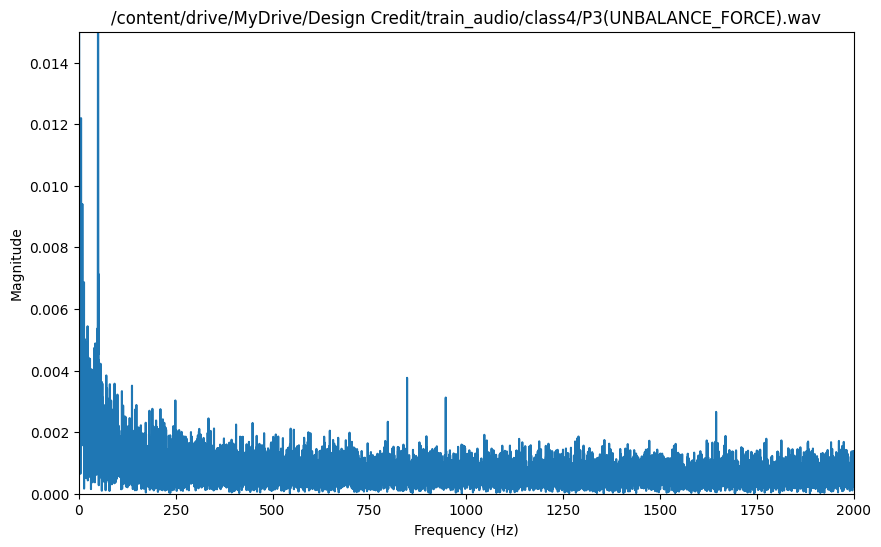

In [19]:
plot_fft(fft)
plt.show()

#### plot fbank

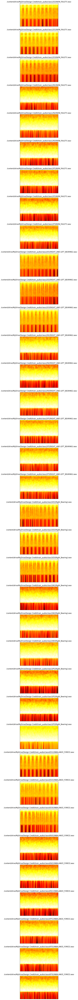

In [20]:
plot_fbank(fbank) 
plt.show()

#### plot mfccs

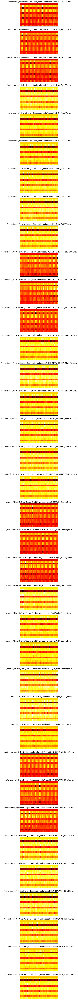

In [21]:
plot_mfccs(mfccs) 
plt.show()

### Visualise Dataset After Envelop
The dead spaces were removed with a threshold of 0.0005 and the signal Mel Spectrogram and FFT were visualized again. The clean signals were into according to their respective classes.

In [22]:
# Create the directory if it does not exist
clean_dir = os.path.join(os.getcwd(), 'clean', c.split('/')[-1])
if not os.path.exists(clean_dir):
    os.makedirs(clean_dir)

In [23]:
# Loop through each subdirectory and load the .wav files
for c in subdirs:
    wav_files = [f for f in os.listdir(c) if f.endswith('.wav')]
    for wav_file in wav_files:
        wav_path = os.path.join(c, wav_file)
        signal, rate = librosa.load(wav_path, sr=44100)
        if not envelope(signal, rate, 0.0005):  # Check if the signal is dead
            continue
        clean_signal = signal[np.abs(signal) > 0.0005]  # Remove values below the threshold
        # Set the path for the clean file
        clean_path = os.path.join(clean_dir, wav_file) 
        sf.write(clean_path, clean_signal, rate)
        signals[wav_path] = signal
        fft[wav_path] = calc_fft(signal, rate)
        bank = logfbank(signal[:rate], rate, nfilt=26, nfft=1103).T
        fbank[wav_path] = bank
        mel = mfcc(signal[:rate], rate, numcep=13, nfilt=26, nfft=1103).T
        mfccs[wav_path] = mel


# Plot the signals, FFT, filterbank energies, and MFCCs

#### Plot Signal

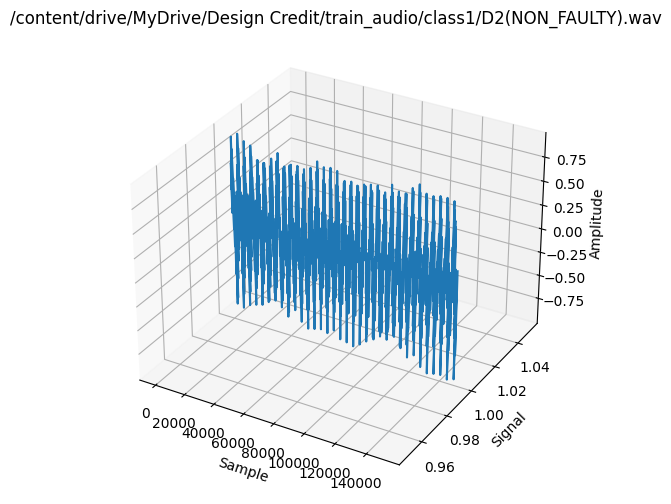

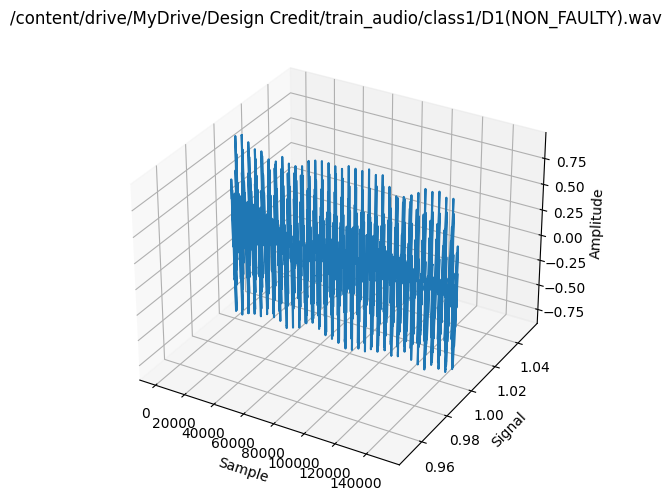

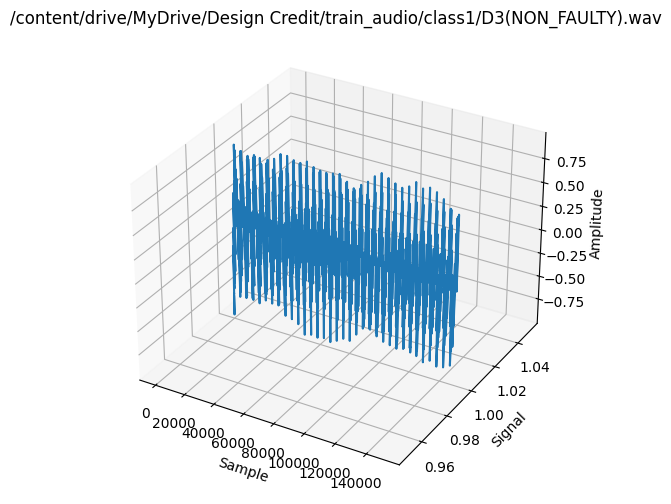

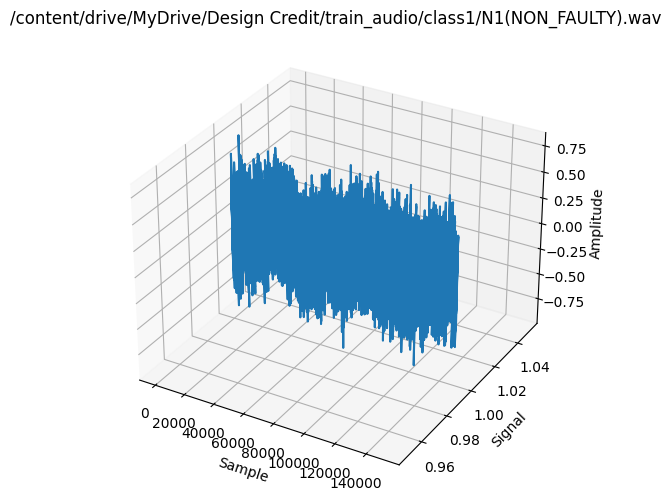

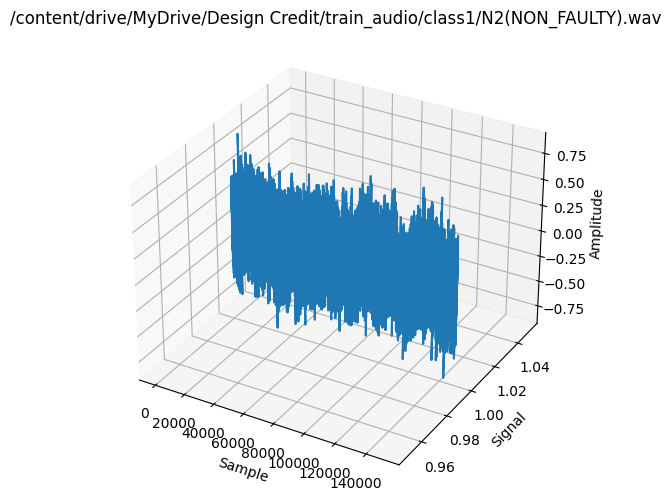

...

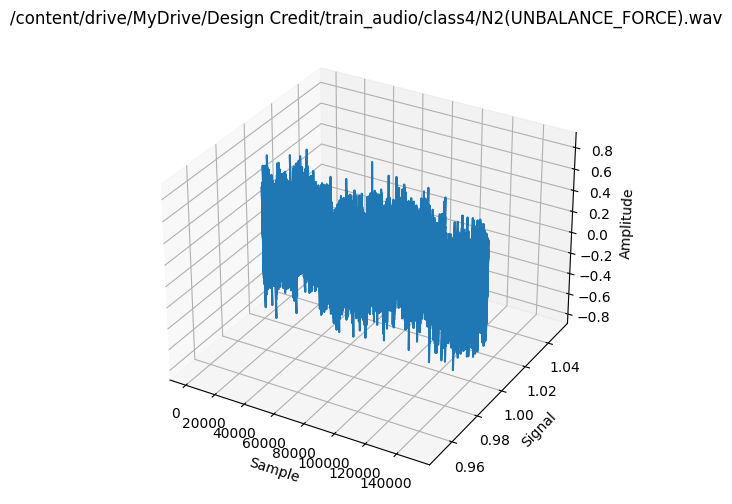

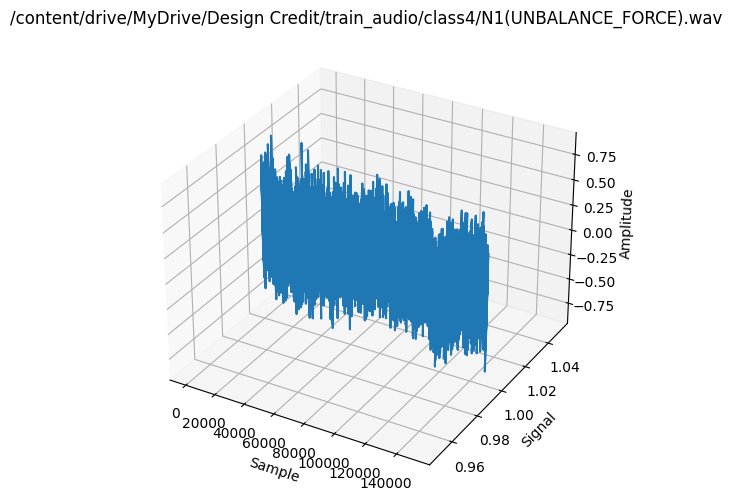

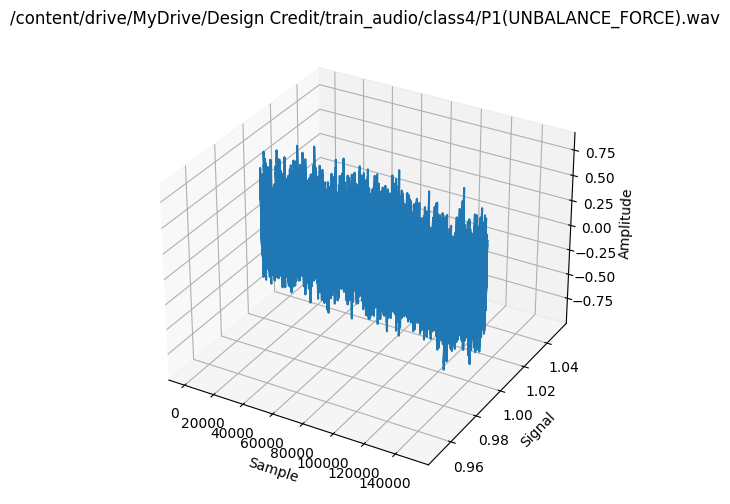

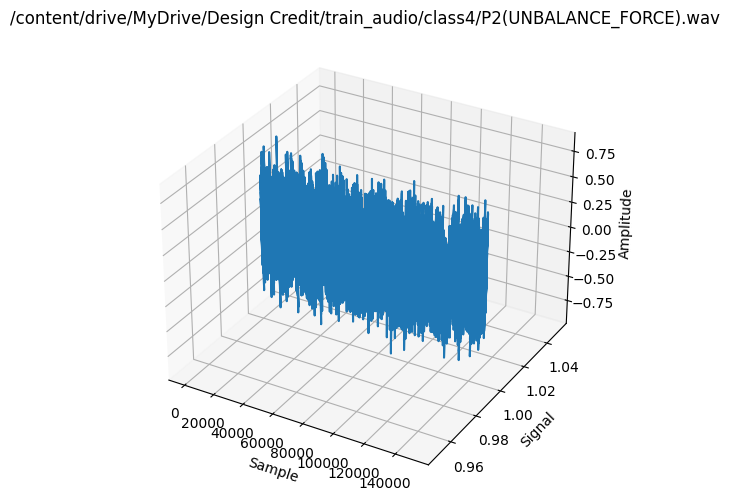

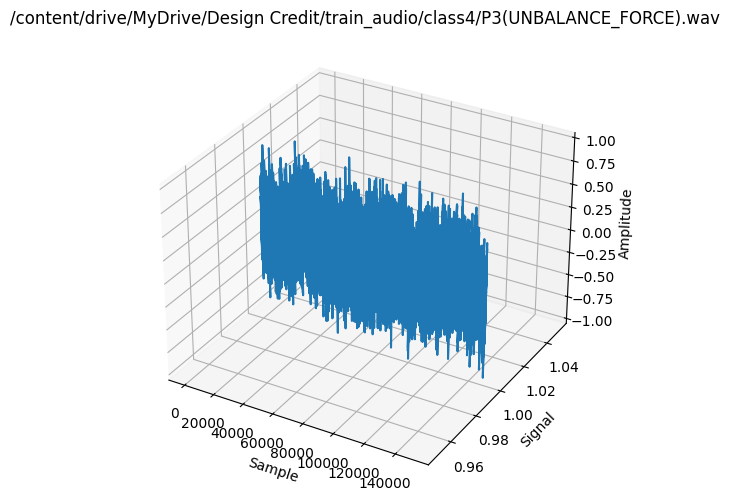

In [24]:
plot_signals(signals) 

#### Plot fft

<ipython-input-15-b3b987038d3f>:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 6))


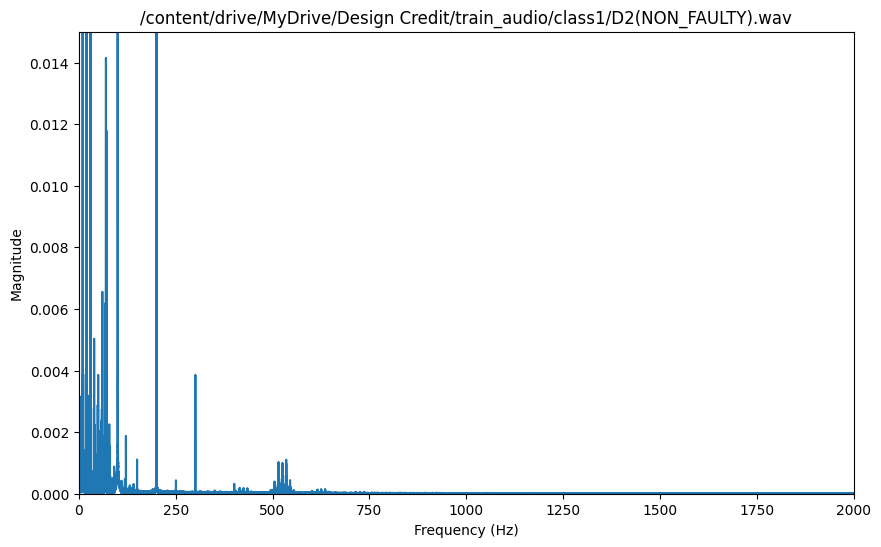

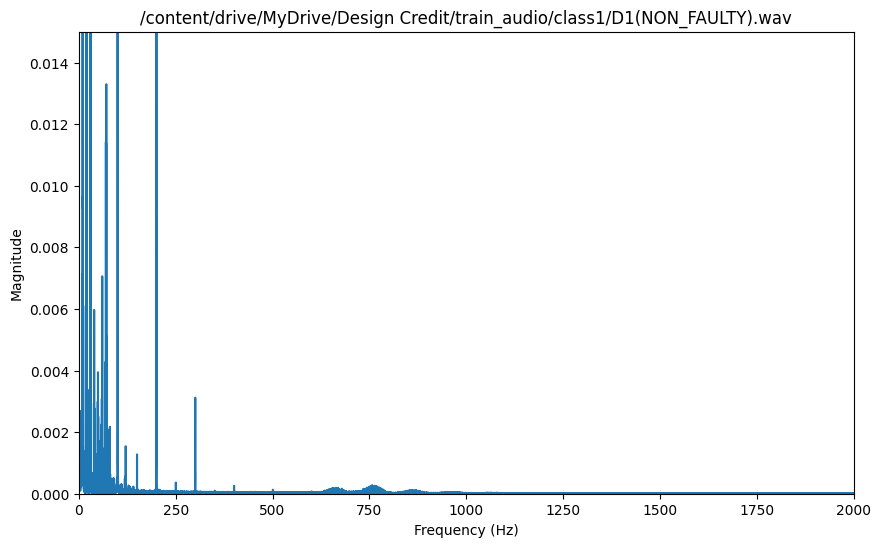

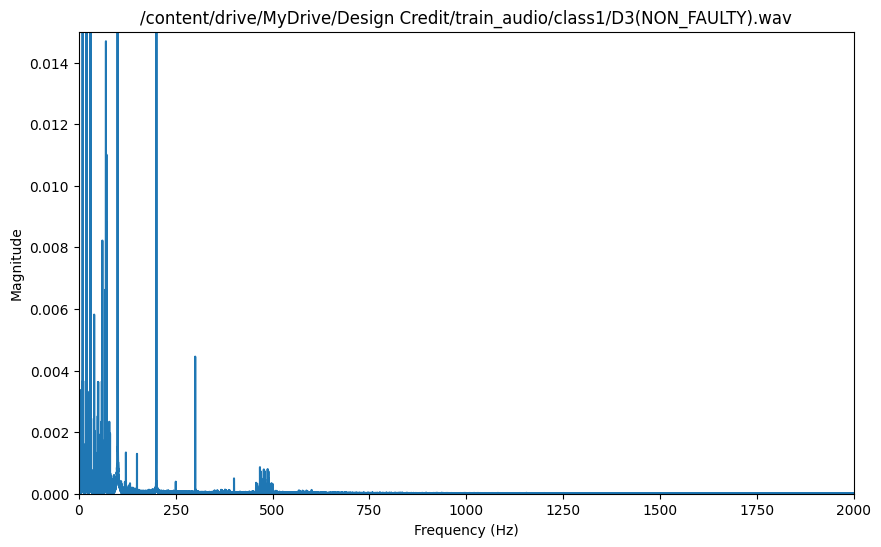

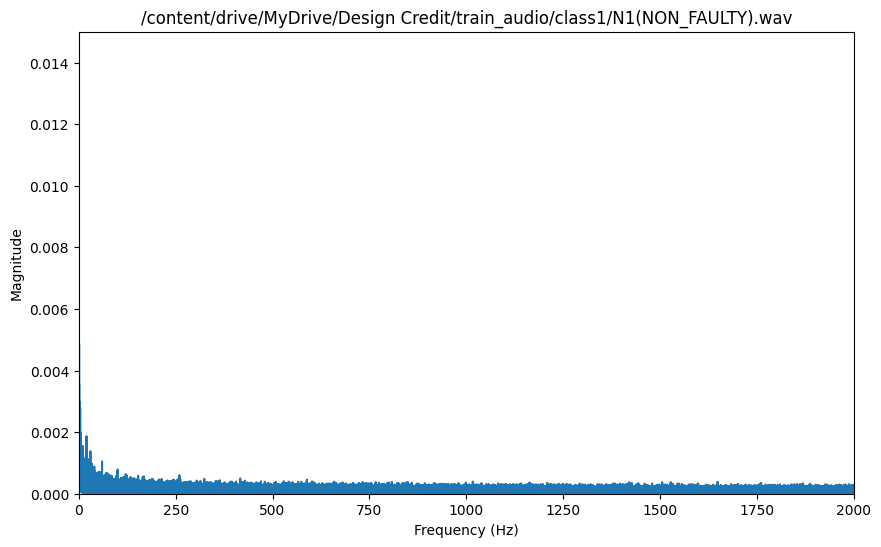

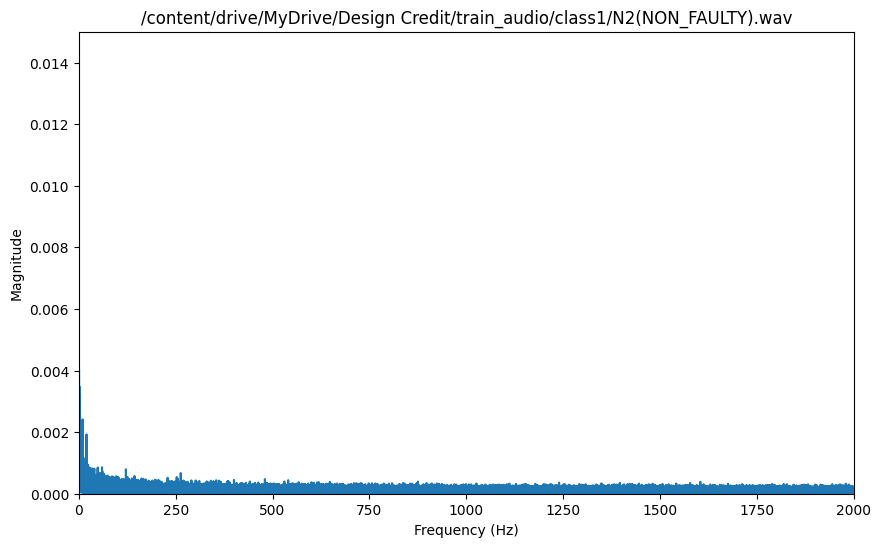

...

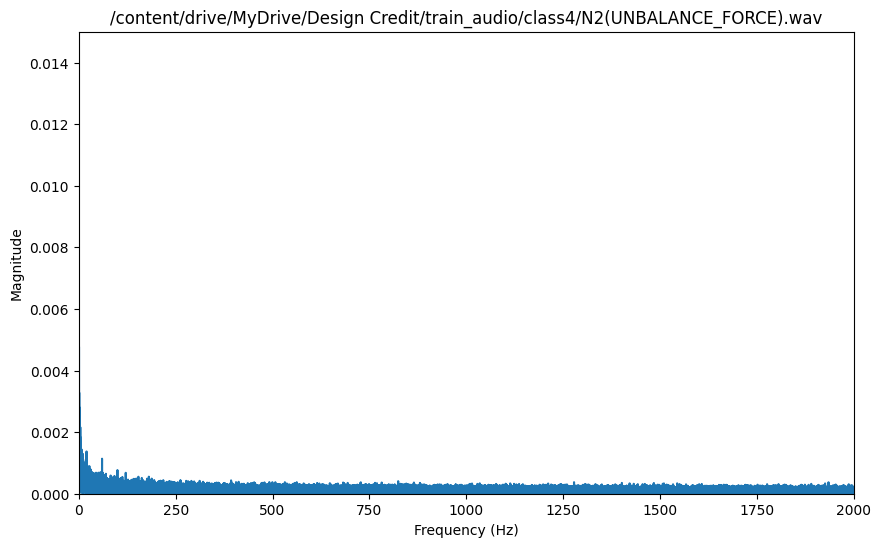

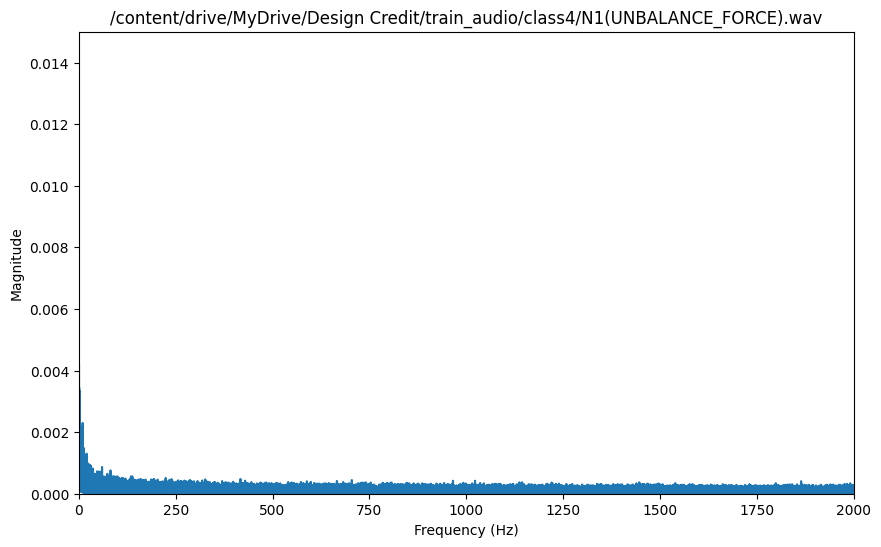

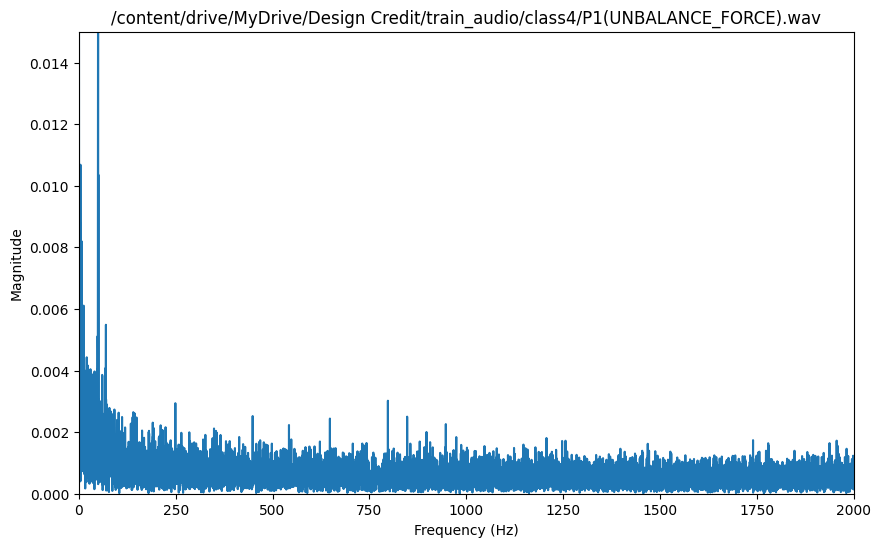

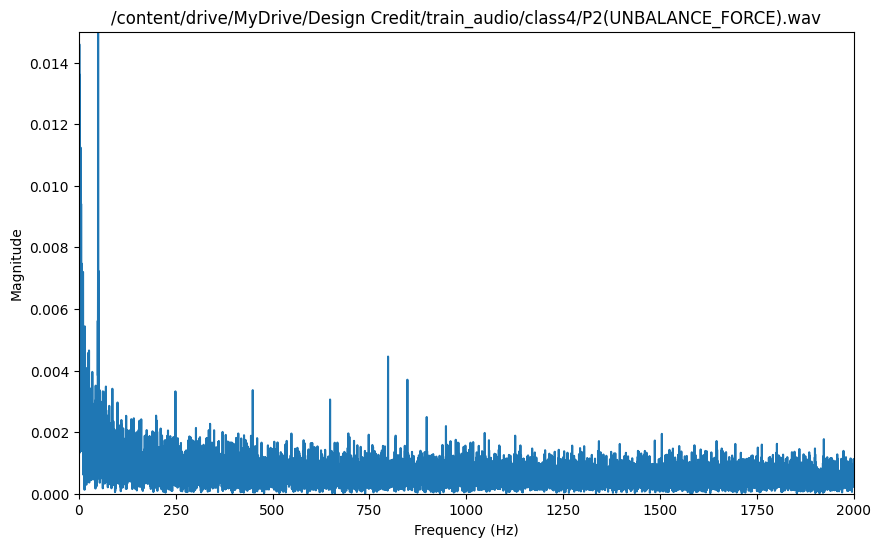

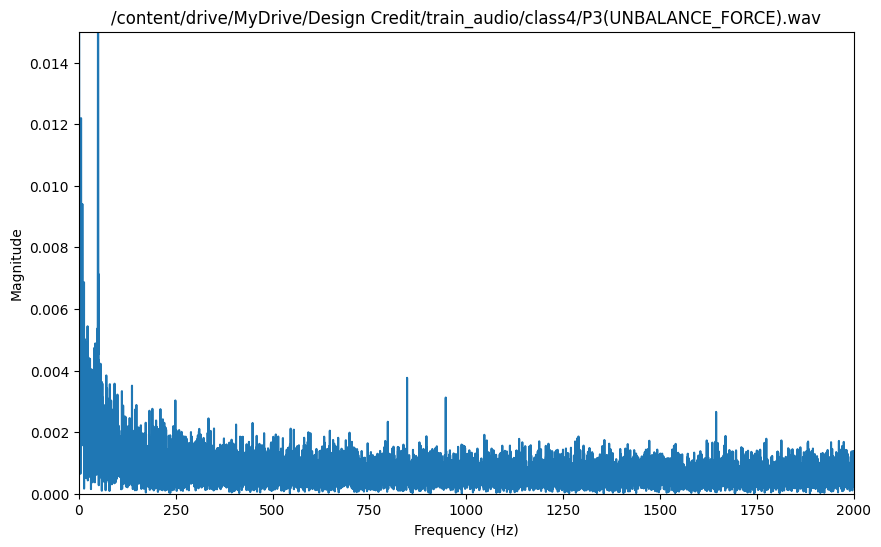

In [25]:
plot_fft(fft)
plt.show()

#### plot fbank

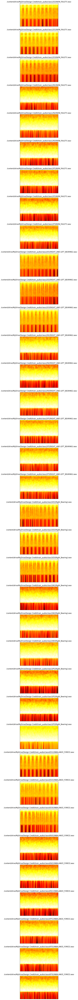

In [26]:
plot_fbank(fbank) 
plt.show()

#### plot mfccs

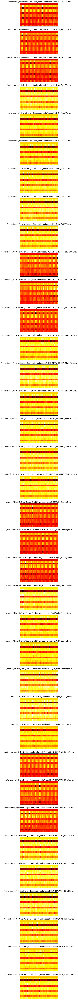

In [27]:
plot_mfccs(mfccs) 
plt.show()

### Save Clean Signal


In [28]:
if not os.path.exists('clean'):
    os.makedirs('clean')

# Loop through each subdirectory and load the .wav files
for c in subdirs:
    if not os.path.exists(os.path.join('clean', c.split('/')[-1])):
        os.makedirs(os.path.join('clean', c.split('/')[-1]))
    wav_files = [f for f in os.listdir(c) if f.endswith('.wav')]
    for wav_file in wav_files:
        wav_path = os.path.join(c, wav_file)
        signal, rate = librosa.load(wav_path)
        clean_signal = signal[np.abs(signal) > 0.0005]  # Remove values below the threshold
        clean_path = os.path.join('clean', c.split('/')[-1], wav_file)  # Set the path for the clean file
        try:
            sf.write(clean_path, clean_signal, rate)
        except Exception as e:
            print(f"Error writing {clean_path}: {e}")
            continue
        signals[wav_path] = signal
        fft[wav_path] = calc_fft(signal,rate)

# Audio classification using convolutional neural networks

Audio classification can be performed by converting audio streams into spectrograms, which provide visual representations of spectrums of frequencies as they vary over time, and classifying the spectrograms using convolutional neural networks (CNNs). 

## Import Clean Sound and Mel spectrogram

The first step is to load the WAV files, use a Python package named Librosa to generate spectrogram images from them, load the spectrograms into memory, and prepare them for use in training a CNN. To aid in this process, we'll define a pair of helper functions for creating spectrograms from WAV files and converting all the WAV files in a specified directory into spectrograms.

In [29]:
import numpy as np
import librosa.display, os
import matplotlib.pyplot as plt
%matplotlib inline

def create_spectrogram(audio_file, image_file):
    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    fig.subplots_adjust(left=0, right=1, bottom=0, top=1)

    y, sr = librosa.load(audio_file)
    ms = librosa.feature.melspectrogram(y=y, sr=sr)
    log_ms = librosa.power_to_db(ms, ref=np.max)
    librosa.display.specshow(log_ms, sr=sr)

    fig.savefig(image_file)
    plt.close(fig)
    
    
def create_pngs_from_wavs(input_path, output_path):
    if not os.path.exists(output_path):
        os.makedirs(output_path)

    dir = os.listdir(input_path)

    for i, file in enumerate(dir):
        input_file = os.path.join(input_path, file)
        output_file = os.path.join(output_path, file.replace('.wav', '.png'))
        create_spectrogram(input_file, output_file)

In [30]:
create_pngs_from_wavs('/content/clean/class1', 'Spectrograms/class1')

In [31]:
create_pngs_from_wavs('/content/clean/class2', 'Spectrograms/class2')

In [32]:
create_pngs_from_wavs('/content/clean/class3', 'Spectrograms/class3')

In [33]:
create_pngs_from_wavs('/content/clean/class4', 'Spectrograms/class4')

##### Define two new helper functions for loading and displaying spectrograms and declare two Python lists — one to store spectrogram images, and another to store class labels.

In [34]:
from tensorflow.keras.preprocessing import image


def load_images_from_path(path, label):
    images = []
    labels = []

    for file in os.listdir(path):
        images.append(np.array(image.load_img(os.path.join(path, file), target_size=(224, 224))))
        labels.append((label))
        
    return images, labels

def show_images(images):
    fig, axes = plt.subplots(3, 3, figsize=(20, 20), subplot_kw={'xticks': [], 'yticks': []})

    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i] / 255)
        
x = []
y = []

#### Mel Spectrograms Of Each class

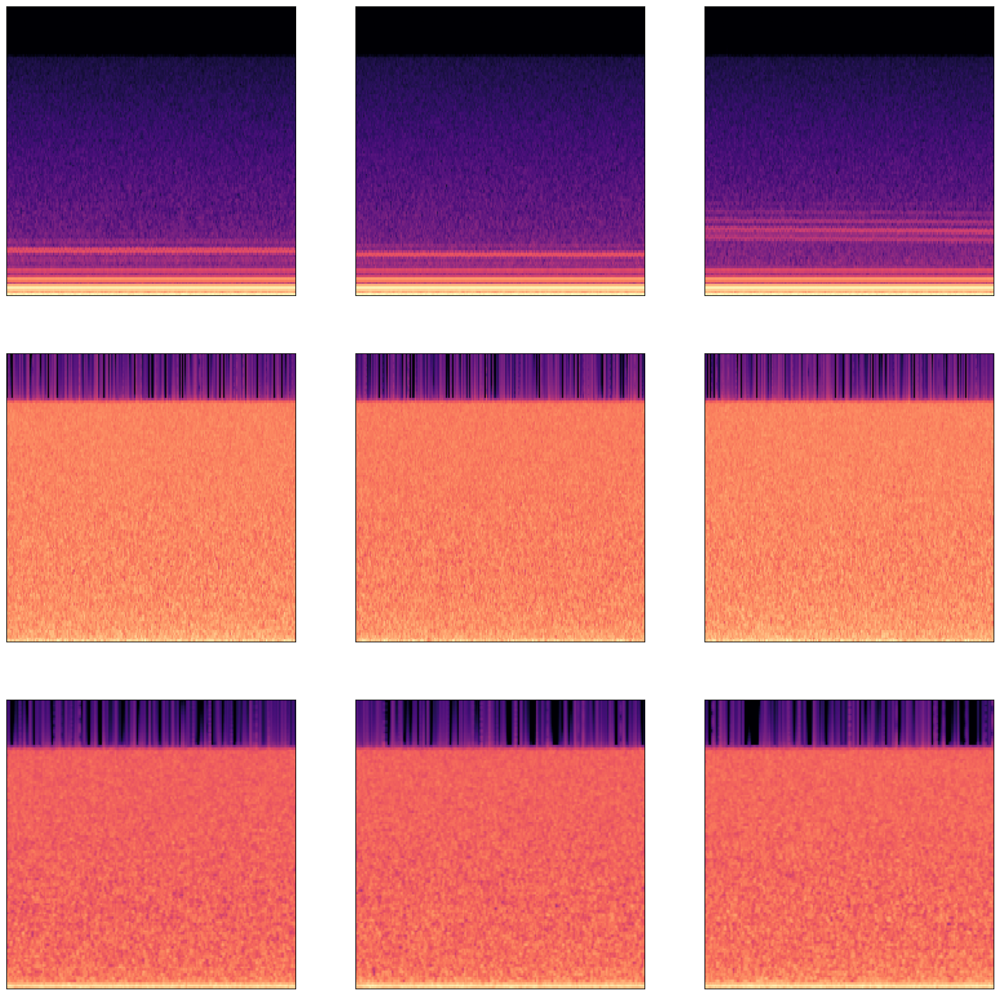

In [35]:
images, labels = load_images_from_path('/content/Spectrograms/class1', 0)
show_images(images)
    
x += images
y += labels

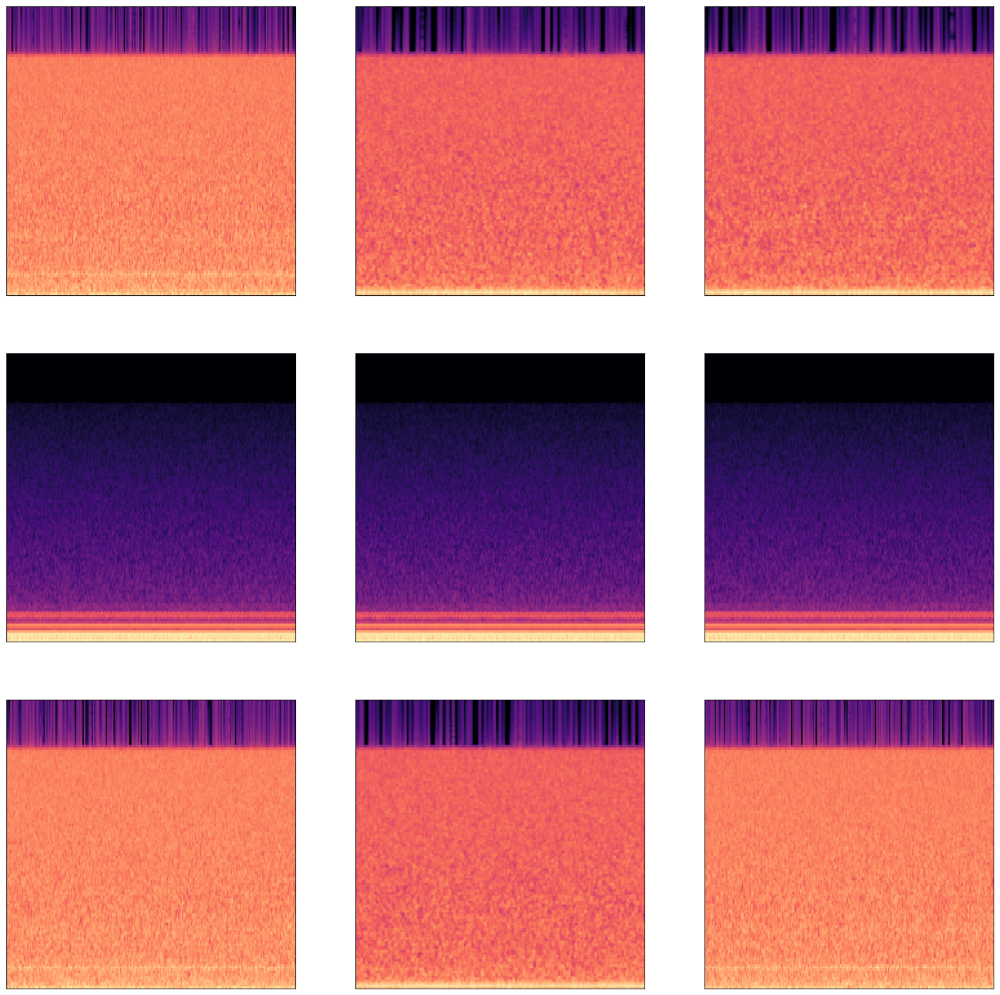

In [36]:
images, labels = load_images_from_path('/content/Spectrograms/class2', 1)
show_images(images)
    
x += images
y += labels

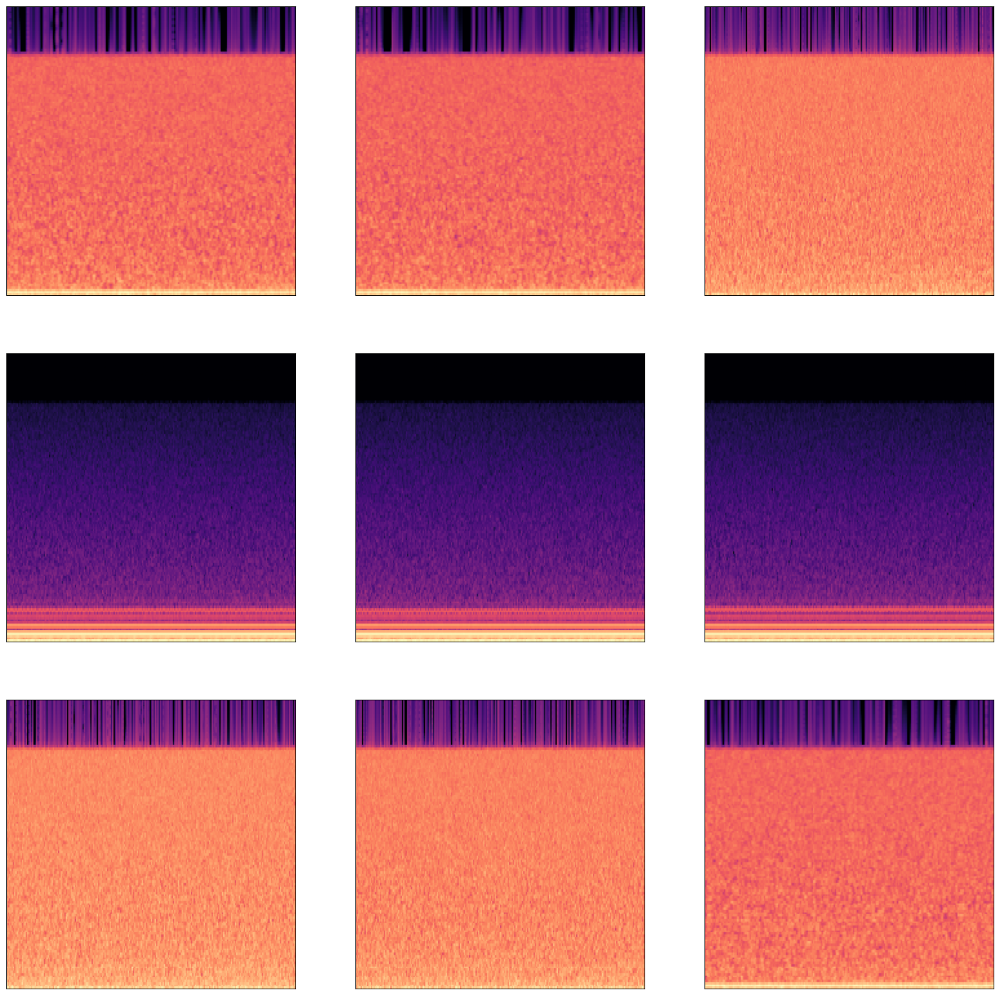

In [37]:
images, labels = load_images_from_path('/content/Spectrograms/class3', 2)
show_images(images)
    
x += images
y += labels

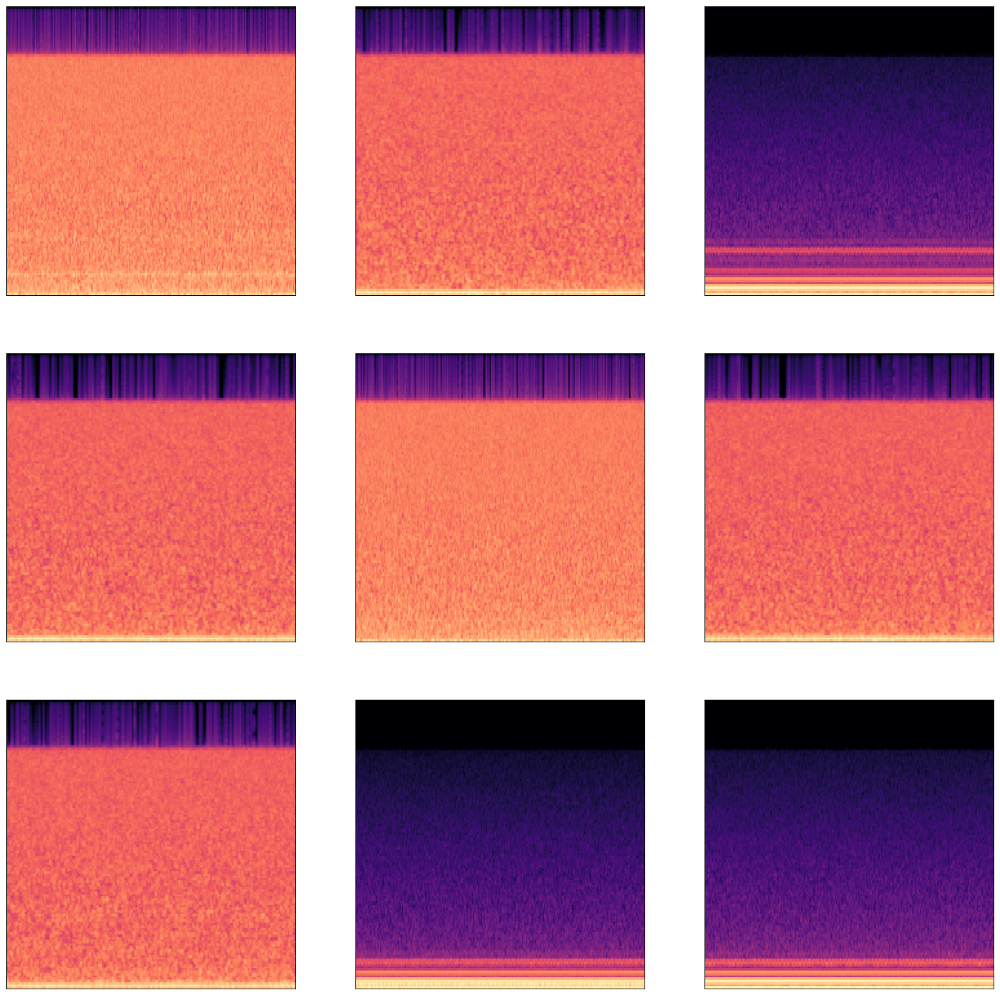

In [38]:
images, labels = load_images_from_path('/content/Spectrograms/class4', 3)
show_images(images)
    
x += images
y += labels

## Split into X_test and y_test


In [39]:
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
import keras

from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Flatten, Dense

x_train, x_test, y_train, y_test = train_test_split(x, y, stratify=y, test_size=0.3, random_state=0)

x_train_norm = np.array(x_train) / 255
x_test_norm = np.array(x_test) / 255

y_train_encoded = to_categorical(y_train)
y_test_encoded = to_categorical(y_test)

## CNN
convolutional neural networks that use convolution layers to extract features from images and pooling layers to downsize images so features can be detected at various resolutions. The next task is to build a CNN containing a series of convolution and pooling layers for feature extraction, a pair of fully connected layers for classification, and a softmax layer that outputs probabilities for each class, and to train it with spectrogram images and labels. Start by defining the CNN

In [40]:
from keras import regularizers

In [41]:
# encode target values as one-hot vectors
num_classes = 4
y_train_encoded = keras.utils.to_categorical(y_train, num_classes)
y_test_encoded = keras.utils.to_categorical(y_test, num_classes)
l2_lambda = 0.001


model = Sequential()
model.add(Conv2D(32, (3, 3), activation='sigmoid', input_shape=(224, 224, 3), kernel_regularizer=regularizers.l2(l2_lambda)))
model.add(MaxPooling2D(2, 2))
model.add(Conv2D(64, (3, 3), activation='sigmoid', kernel_regularizer=regularizers.l2(l2_lambda)))
model.add(MaxPooling2D(2, 2))
model.add(Conv2D(128, (3, 3), activation='sigmoid', kernel_regularizer=regularizers.l2(l2_lambda)))
model.add(MaxPooling2D(2, 2))
model.add(Conv2D(256, (3, 3), activation='sigmoid', kernel_regularizer=regularizers.l2(l2_lambda)))
model.add(MaxPooling2D(2, 2))
model.add(Flatten())
model.add(Dense(1024, activation='sigmoid', kernel_regularizer=regularizers.l2(l2_lambda)))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='sigmoid'))
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# train the model
batch_size = 10
epochs = 10
hist = model.fit(x_train_norm, y_train_encoded, validation_data=(x_test_norm, y_test_encoded), batch_size=batch_size, epochs=epochs)


Epoch 1/10
5/5 [==============================] - 15s 2s/step - loss: 6.5026 - accuracy: 0.5000 - val_loss: 6.7654 - val_accuracy: 0.5789
Epoch 2/10
5/5 [==============================] - 10s 2s/step - loss: 6.7465 - accuracy: 0.5455 - val_loss: 5.9957 - val_accuracy: 0.5789
Epoch 3/10
5/5 [==============================] - 12s 3s/step - loss: 6.2848 - accuracy: 0.3636 - val_loss: 5.2881 - val_accuracy: 0.5789
Epoch 4/10
5/5 [==============================] - 12s 2s/step - loss: 5.1590 - accuracy: 0.5000 - val_loss: 4.3935 - val_accuracy: 0.5789
Epoch 5/10
5/5 [==============================] - 10s 2s/step - loss: 4.5472 - accuracy: 0.5227 - val_loss: 3.6323 - val_accuracy: 0.5789
Epoch 6/10
5/5 [==============================] - 11s 2s/step - loss: 3.5969 - accuracy: 0.5227 - val_loss: 3.3650 - val_accuracy: 0.5789
Epoch 7/10
5/5 [==============================] - 11s 2s/step - loss: 3.5898 - accuracy: 0.4091 - val_loss: 3.2574 - val_accuracy: 0.5789
Epoch 8/10
5/5 [==================

[Go to next Colab File](https://colab.research.google.com/drive/1_Tp864kC1I4ds50NVuXq_xrAQnC61MSt?usp=sharing)